# Analyzing & Visualizing NextGen Reads with Magic-BLAST

This Jupyter Notebook contains the background and instructions for the hands-on exercises of this workshop:

* [Introduction](#Introduction)
* [Objective 0 - Introduction to our computing environment and software packages](#Objective-0)
* [Objective 1 - Aligning DNA-seq for SARS-CoV-2 to the reference genome tp identify sequence changes.](#Objective-1) 
* [Objective 2 -  Finding expressed genes on a whole-genome shotgun sequence using mRNA annotation from a related species](#Objective-2)
* [Objective 3 - Align RNAseq data to reference and visualize transcript coverage and diversity](#Objective-3)
* [Conclusions and Further Reading](#Conclusions) 

# Introduction

Next generation (next-gen) sequencing has become the standard method for obtaining genomic and transcriptomic sequences; however analysis of the large number of short reads can be complicated and requires specialized software.  NCBI has developed a variation of the BLAST algorithm, Magic-BLAST, to align next-gen reads to a reference nucleotide sequence.  You can import the read alignment results from Magic-BLAST into one of NCBI’s genome browsers to visualize them alongside your choice of hundreds of other NCBI annotation tracks. Thus, without having to go through a sequence assembly step, you can quickly assess the sequence set for genetic variations and map potential gene annotations.

This workshop is designed for researchers already working with next-gen data and performing DNAseq or RNAseq experiments and who use command-line tools for bioinformatic analysis. 

## About Jupyter Notebooks and this workshop  
This workshop uses a Jupyter Notebook, a platform that allows you to run code from individual cells in a web page and display the results of the command.  

In this notebook the language of the code cells is simply the Unix bash shell that you can use to run command-line tools (MagicBLAST, blastn, efetch, etc.) or invoke any standard Unix programs or utilities (ls, grep, head, tail, sort, cut etc.)

In some cases the commands will create files on your working directory on the server. When that happens a new file will appear in the list on the left-hand side of your notebook.  

To run code in a cell you can select the cell and  use the "Run" button at the top of the notebook, or you can use hold the shift key down and press the enter key (shift+enter) to run the cell.

**Example:** Run the following cell. This will create file on your working directory, list the contents of your directory, and list the contents of your file.

In [ ]:
# Creating a file with Unix
echo "This is my file" > myfile
ls -l | grep myfile
cat myfile

The output appears immediately below the cell. Notice that the new file appears in the list on the left-hand side of your browser. Also, the bracketed space to the left of the cell now contains the number 1 \[1]. The number is the number of times you have run cells in the notebook. When the cell is running the brackets will show an asterisk \[*].

**Important tip:** Some cells in the notebook require that you have run the cells before them. If you missed a previous cell, you can use the "Run" menu to "Run All Above the Selected Cell"

### Sofware installed on this notebook
In addition to MagicBLAST the following bioinformatics tools are installed on this server for use during the workshop:  
- **EDirect**: a suite of scripts for accessing NCBI sequence and literature data through the E-Utilities API. [More info](https://www.ncbi.nlm.nih.gov/books/NBK179288/)
- **Standalone BLAST**: standard sequence databas search and alignment tools and utilities from NCBI. [More info](https://www.ncbi.nlm.nih.gov/books/NBK279691/)
- **SamTools**: tools for manipulating Sequence Alignment Map (SAM) files and related file types. [More info](http://www.htslib.org/doc/samtools.html)

## What is MagicBLAST?

MagicBLAST is a BLAST-based short read (next-gen) alignment tool. It can align DNA-seq and RNA-seq reads to a genome or a transcriptome. Unlike other short read aligners MagicBLAST doesn't require indexing of the database, but searches a BLAST database made from the target reference.  MagicBLAST also offers the following capabilities:
- Takes advantage of paired read information when mapping reads
- Recognizes and uses splice site signals when aligning RNA-seq to genomes and can accurately find introns
- Retrieves short read data from NCBI's Sequence Read Archive (SRA) from locations in the cloud
- Works with local next-gen data in many common formats
- Produces alignment output in both SAM and more human-readable tabular formats
- Performs better than other alignment tools on next-gen long reads such as those produced by PacBio 

The MagicBLAST publication has details on performance and comparisons to other popular short-read aligners.

Boratyn GM, Thierry-Mieg J, Thierry-Mieg D, Busby B, Madden TL. (2019) **Magic-BLAST, an accurate RNA-seq aligner for long and short reads.** 
*BMC Bioinformatics* 20: 405.\[[article](https://bmcbioinformatics.biomedcentral.com/articles/10.1186/s12859-019-2996-x)\] 

Visit the [GitHub repository](https://ncbi.github.io/magicblast/) for additional details on usage and command-line options.



**Try it out!** You can test run the magicblast application and see all options by executing the command-line in the following cell.

In [ ]:
magicblast -help

A typical MagicBLAST command-line would be

magicblast **-query/-sra** \[file/SRA run accession\] **-db** \[reference genome/transcriptome BLAST database\] \\  
(-paired) (-splice \[T/F\]) (-no_unaligned) (-limit_lookup \[T/F\]) -outfmt \[sam/tabular\]


**-query or -sra**  The next-gen reads to align to the reference genome or transcriptome. The -sra option pulls these using the SRA run accession from NCBI in the cloud.  

**-db** The reference genome or transcriptome as a BLAST database. You can generate a BLAST database from a FASTA sequence file using the BLAST utility makeblastdb, which is also installed on this Jupyter Hub.  


**-spliced** Indicate whether the program should break alignments across splice junctions. Set to false for transcriptome or prokaryotic genome. 


**-limit_lookup** limits lookup for for word matches that occur more that ten times. Helps to avoid matches to repeat sequences. Set to false for transcriptome (or viral genome).  


**-paired** Indicate if the next-gen reads are paired.  


**-no_unaligned** Excludes reads with no alignment from the output.  


**-outfmt** Choose output format: tabular, a human readable tab-delimited output, or Sequence Alignment/Map (SAM), which can be processed and reformatted by **samtools**, also installed on this Jupyter Hub.  

**Note:** The default settings for MagicBLAST presume aligning rna-seq to a genomic sequence  
(-spliced T -limit_lookup T -outfmt sam) 


## Example 1. Aligning DNA-seq for SARS-CoV-2 to the reference genome and identify sequence changes. 
In this example, we'll use MagicBLAST to look for sequence variants in a viral sample. We'll align next-gen reads from a SARS-CoV-2 patient sample collected in California on June 23, 2020 to the SARS-CoV-2 genome reference sequence. The reference sequence is from a sample from Wuhan, China in December 2019 and probably represents the sequence of the earliest lineage of SARS-CoV-2 in humans.  

### Step 0: Configuring edirect
Please run the cell below to configure the EDirect programs!

In [ ]:
source /srv/scratch/.bash_profile
#Don't worry, you won't see anything happen.

### Step 1 Retrieving the SARS-CoV-2 Reference  
It's easy to find the SARS-CoV-2 on the NCBI website. Simply perform an 'All Databases' search for [SARS-CoV-2 genome](https://www.ncbi.nlm.nih.gov/search/all/?term=SARS-CoV-2%20genome).    
![All Database search results for SARS-CoV-2 genome showing an information box with a direct link to the genome sequence record](attachment:28af1718-4b4c-49d5-ab38-22733f43d247.png "SARS-CoV-2 Genome All Databases Search Results")
  

The link on the result takes you to the nucleotide record for the genome sequence, [NC_045512.2](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512.2).  

![SARS-CoV-2 Reference genome sequence record in GenBank format in the Nucleotide database](attachment:466152dc-f054-4ebe-b1a5-e9b7d03539c1.png "SARS-CoV-2 Reference Genome Sequence Record")  

You can easily download this sequence to your local computer from this webpage (or from the 'Download' button on the orginal result from the 'All Databases' search). However, it's more difficult to download from the web to your home directory on this Jupyter Hub. To download, we'll use the [EDirect package](https://www.ncbi.nlm.nih.gov/books/NBK179288/) that provides command-line access to many databases (PubMed, Nucleotide, Protein, etc.) at NCBI. The package is installed on this Jupyter Hub. We'll just be using the efetch program here to download the genome sequence.  
  
Run the command in the next cell to retrieve the SARS-CoV-2 reference and save it to a file on your home directory.
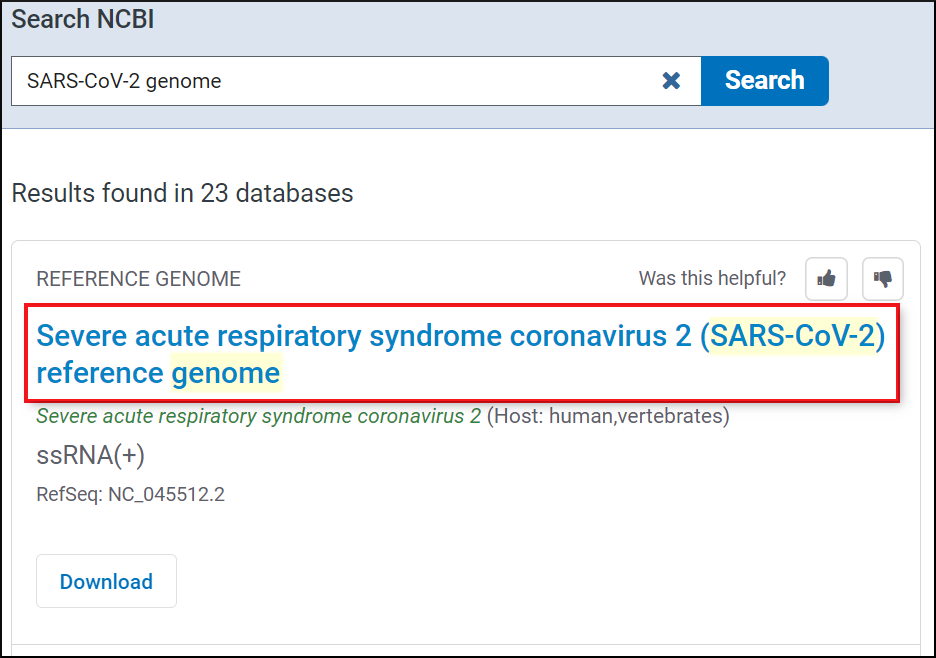
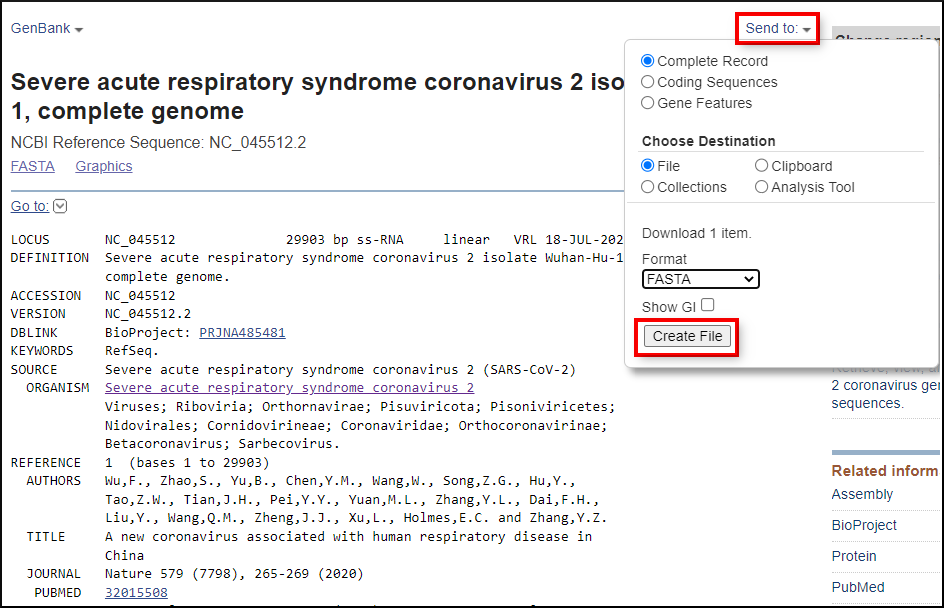

In [ ]:
efetch -db nuccore -id NC_045512.2 -format fasta > NC_045512.fna
head NC_045512.fna

The genome sequence you downloaded is based on an original December 2019 isolate from Wuhan, China.  
 ```  
 source          1..29903  
                     /organism="Severe acute respiratory syndrome coronavirus 2"  
                     /mol_type="genomic RNA"  
                     /isolate="Wuhan-Hu-1"  
                     /host="Homo sapiens"  
                     /db_xref="taxon:2697049"  
                     /country="China"  
                     /collection_date="Dec-2019"
```                     
The SARS-CoV-2 virus has evolved many variant lineages since then. We'll use MagicBLAST to align next-gen reads from a later isolate to this reference.  
  
### Step 2. Identifying other SARS-CoV-2 isolates




We can use the [web interface to SRA](https://www.ncbi.nlm.nih.gov/sra/) to find samples from mid-2020 to compare to the reference. Search SRA for [2020/07[Publication Date] AND SARS-CoV-2[Organism] AND San Diego](https://www.ncbi.nlm.nih.gov/sra/?term=2020%2F07%5BPublication+Date%5D+AND+SARS-CoV-2%5BOrganism%5D+AND+San+Diego).  

Click the link at the top to "Send results to Run selector" and search within the results for 2020-06-23 collection date. We'll use [**SRR12348966**](https://trace.ncbi.nlm.nih.gov/Traces/index.html?view=run_browser&acc=SRR12348966&display=metadata) as our run for the alignment.  

![SRA interface showing search results for SARS-CoV-2 experiments from San Diego](attachment:18b6fdb4-bba4-45d1-9e9a-a3dda8c7e5a9.png "SRA Search Results")
<!--- 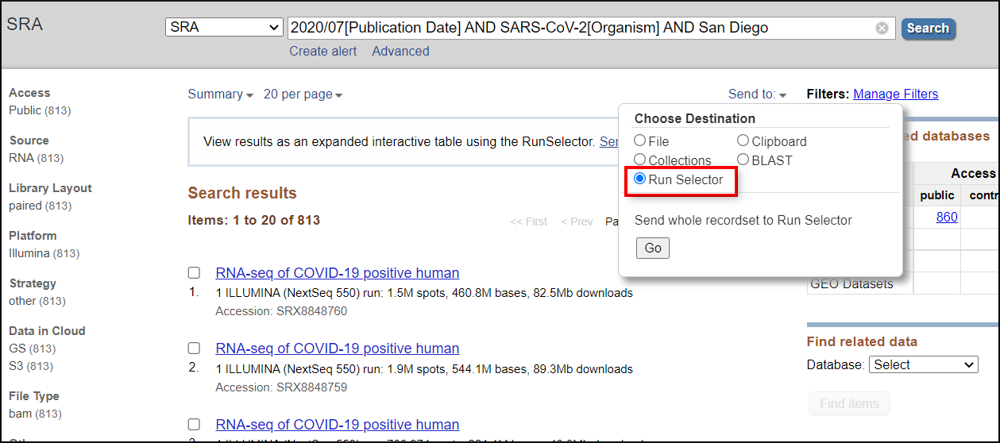 --->


![Run selector interface show runs from SRA for San Diego in 2020](attachment:d595b356-89f0-4d9f-a822-cd496f5c5be2.png "SRA Run Selector")  



### Step 3. Making a BLAST database from the reference

We'll use makeblastdb, a program that is part of the NCBI standalone BLAST package, to generate a BLAST database from the SARS-CoV-2 reference sequence. Run the following command-line to create the BLAST nucleotide database.
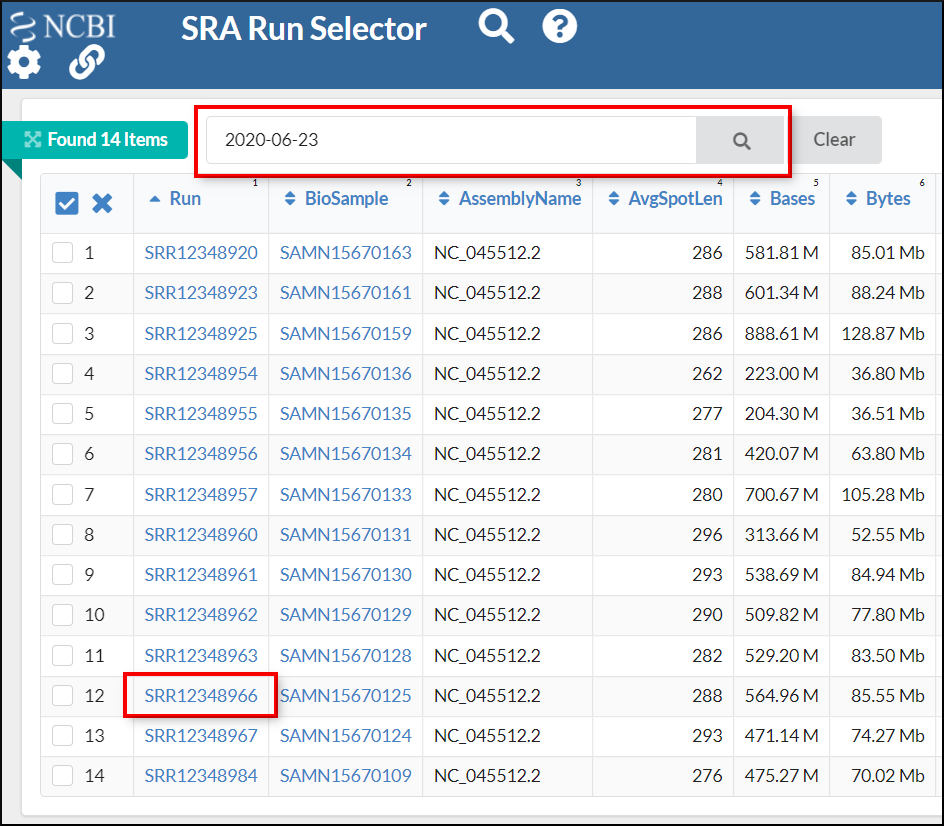

In [ ]:
makeblastdb -in NC_045512.fna -dbtype nucl -parse_seqids -out NC_045512
ls -l | grep NC_045512

#### Step 4. Aligning the reads to the SARS-CoV-2 reference
We're now ready to align the reads to the genome. Since the reference here is a viral genome we don't need to worry about splicing or repeats. Notice that this experiment has paired reads.  

![SRA Run Browser showing the SRA run (SRR12348966) from San Diego, June 2020 ](attachment:Run_broswer.png "SRA Run Browser")  

A popular format for next-gen alignments is Sequence Alignment Map (SAM) format and the compressed binary version, Binary Alignment Map (BAM) format.  The [samtools](http://www.htslib.org/) package is essential for working with these formats (interconverting, sorting, indexing, dumping out regions, etc.). You can read more about how to use samtools and the various commands in [the manual](http://www.htslib.org/doc/samtools.html).    

Execute the following command to output the MagicBLAST alignment in SAM format. (This will take a few minutes to run).
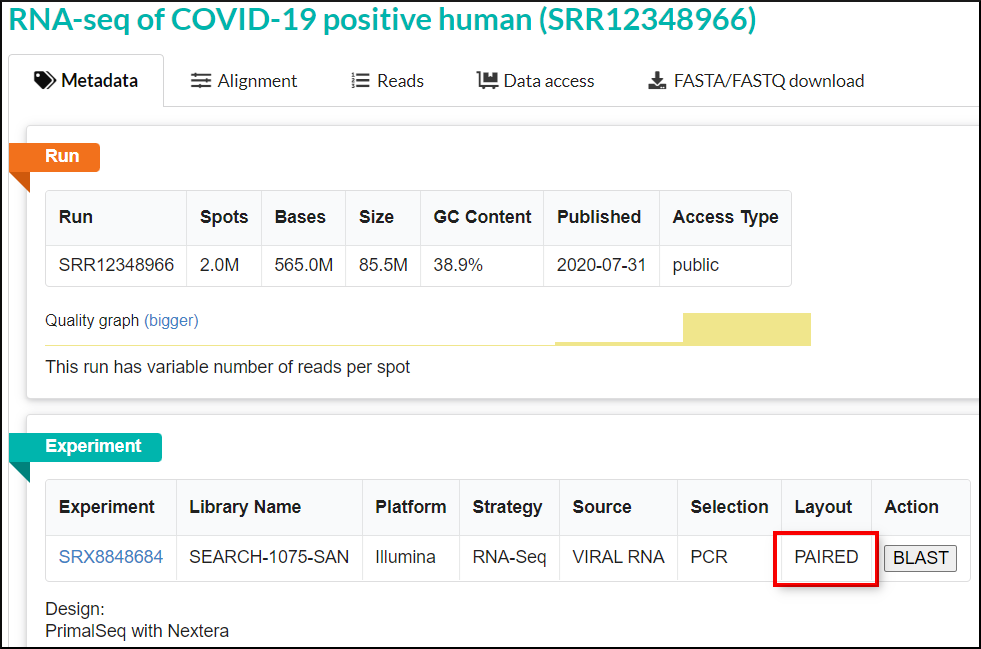

In [ ]:
magicblast -sra SRR12348966 -db NC_045512 -splice F -limit_lookup F -paired -no_unaligned -num_threads 4 -outfmt sam > SRR12348966.sam
head SRR12348966.sam

SAM format is a tab-delimited text format that is (somewhat) human readable. It is information rich and includes details about the individual alignments including the sequence. This level of detail allows graphical viewers to display the bases in the alignment. The [technical description of the SAM format](https://samtools.github.io/hts-specs/SAMv1.pdf) and related formats is available from the SAMTools GitHub repository.

SAM is not space efficient and many progams use the more compact Binary Alignment Map (BAM) format, which is a compressed binary version of SAM.  

We'll use the BAM format to load the alignments into the NCBI viewers.

### Step 5. Generating BAM and the BAM index for streaming in the NCBI grapical viewers
SAM/BAM format can be read by a number of bioinformatics tools. Typically you'll need a a sorted BAM and a BAM index file.     

Run the following command to generate a sorted BAM file from your SAM file. The sorted BAM has the alignments sorted by position on the genome.

In [ ]:
samtools view -bS SRR12348966.sam | samtools sort -o SRR12348966_sorted.bam -O BAM
ls -l | grep SRR12348966_sorted.bam

To load the BAM into the graphical sequence viewer, we'll need an index file. Indexing a genome sorted BAM file makes it possible to quickly extract alignments from specific genomic regions and is required by most genome viewers including the NCBI Sequence Viewer and Genome Data Viewer to display the alignments.   

Run the following command to generate an index file for the BAM.

In [ ]:
samtools index SRR12348966_sorted.bam SRR12348966_sorted.bam.bai
ls -l | grep SRR12348966_sorted.bam.bai

Run the following commands to generate a BAM file and index that contains the region of the spike protein gene ([NC_045512.2 : 21563-25384)](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512.2?from=21563&to=25384&report=gbwithparts).  This will generate a smaller file that will load faster in the viewer, and contains alignments to the region of greatest immunological interest.

In [ ]:
samtools view -o subset_SRR12348966_sorted.bam SRR12348966_sorted.bam NC_045512.2:21563-25384
samtools index subset_SRR12348966_sorted.bam subset_SRR12348966_sorted.bai
ls -l | grep subset_SRR12348966_sorted.bai

### Step 6. Loading the next-gen alignment into the graphical view of the SARS-CoV-2 reference genome
The BAM and BAM index files are on the [workshop directory on the FTP site](https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2023/NextGenMagicBlast_Oct/). You can load (stream) the remote BAM file as a track on the SARS-CoV-2 genome in the graphics view. For this to work you need the BAM file (subset_SRR12348966_sorted.bam, in our case) and the index file (subset_SRR12348966_sorted.bai, in our case) in the same directory.  

Open the [graphical view of NC_045122](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512.2?report=graph)  
- Use the Search feature to jump to position 23,403 of the genome before loading the remote file. (This is a position in the spike protein gene where there was an early change in the sequence of circulating viruses.) 
- Open the "Tracks -> Configure tracks" menu (screen shot below).  
- Choose the "Custom Data" tab.  
- Select "Remote Files."  
  
 ![The Graphical Sequence Viewer configure menu showing the Remote data section where you can put a URL that points to a BAM](attachment:be449e77-c134-425f-84f5-5273f97325b4.png "Graphical Sequence Viewer Configure Menu")
- Copy and paste the following URL to the sorted BAM file into the box on the form   
`https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2023/NextGenMagicBlast_Oct/subset_SRR12348966_sorted.bam`
- Click the "Register" button and wait for the track to register
- Click the "Configure" button.  
The track will load, but it may take a minute or so. Be patient.  
- You may need to confure the BAM track to 'Show All' in the 'Alignment Display'

![The Configure Menu of the BAM alignment track in the Viewer showing how to set the Alignment Display to Show All](attachment:f77b2288-9d97-4aab-a39a-b27d8a8d3032.png "BAM alignment track Configure Menu")  
Your viewer should look like the screenshot below once the BAM loads completely. 
  
You should see that the aligned reads have a G base at this position compared to the reference A. This would change the aspartate residue in the spike protein to a glycine. This is one of the first major changes observed in the circulating SARS-CoV-2 virus. The lineage containing the glycine codon quickly replaced the lineages with the aspartate codon. All subsequent variants of concern have the glycine codon at this position.


![Graphical Sequence Viewer showing next-gen read alignments to the SARS-CoV-2 Reference genome and highlighting in red the column of G bases in the aligned reads](attachment:6c51a862-346e-498a-b780-ff618491ab50.png "Graphical Sequence Viewer of SARS-CoV-2 Genome with Remote BAM Loaded")
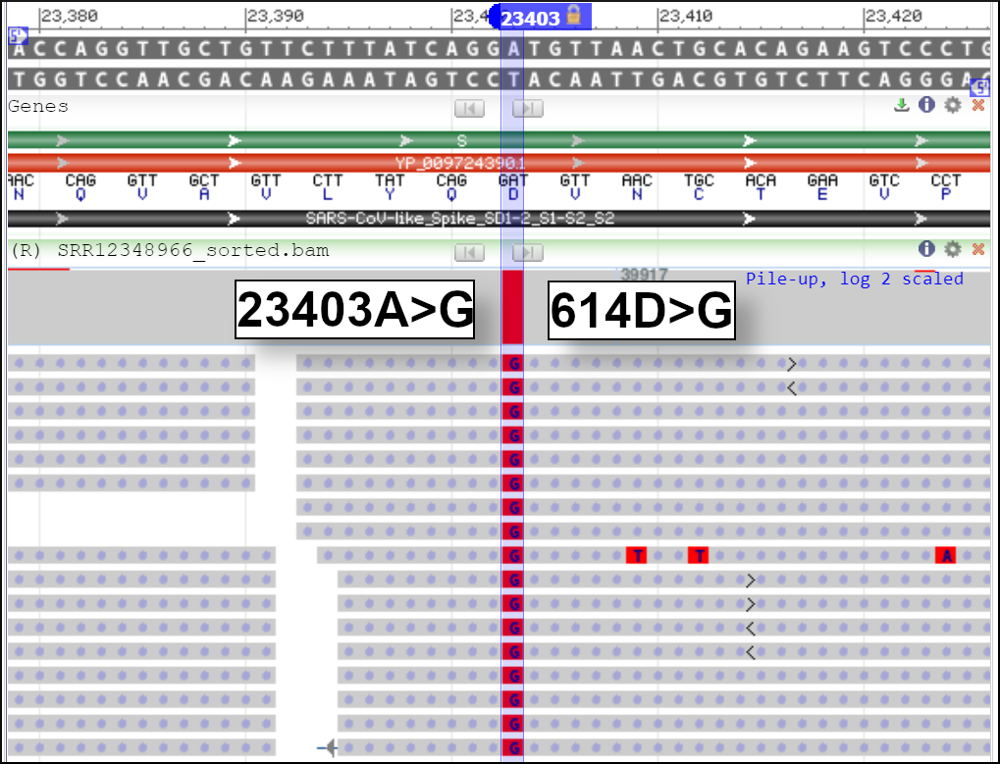
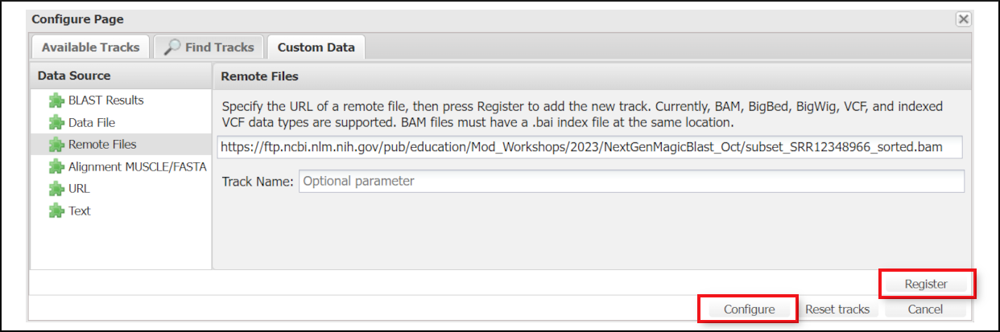
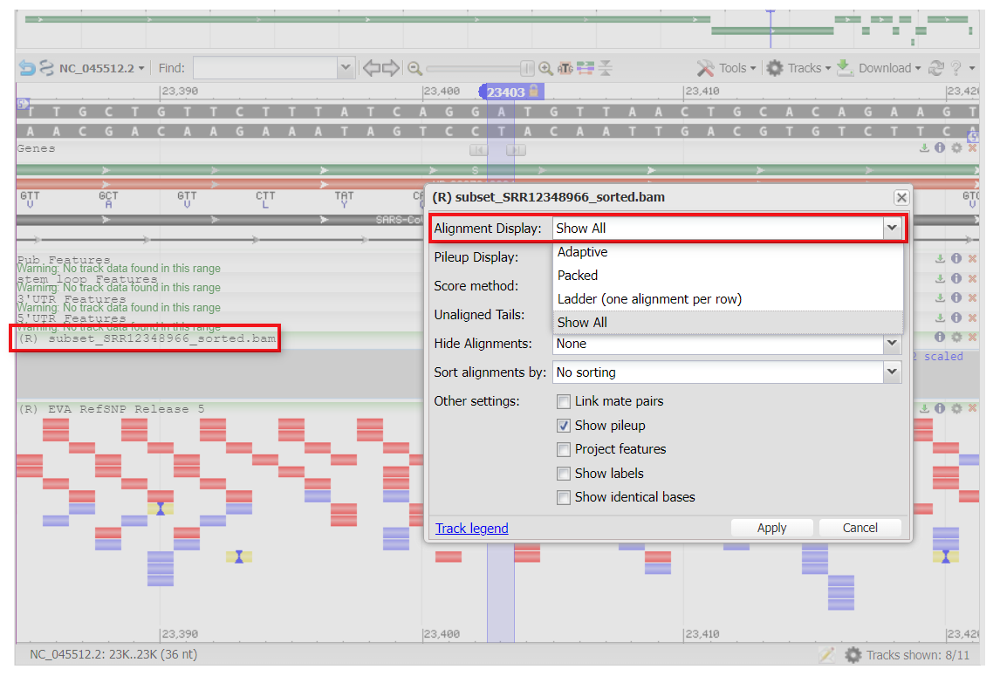

## \[Optional\] Example 2. Finding expressed genes on a Fin Whale (_Balaenoptera physalus_) whole-genome shotgun sequence using the Blue Whale mRNA annotation

In this example, we'll use complete transcript sequences from an annotated genome (Blue Whale) to identify genes on an unannotated genome sequence from a closely related species (Fin Whale). We'll be working with a local query file in FASTA format rather than streaming SRA data from the cloud.  

We'll focus on the region surrounding the myoglobin gene, a gene of interest in whales because of its role as an oxygen source for muscle during dives.

### Step 1. Using BLAST to find a candidate contig containing the myoglobin gene to annotate  
First we'll get the blue whale (_Balaenoptera musculus_) query sequence for myoglobin. The following command line will find and retrieve the sequence. 

In [ ]:
esearch -db nuccore -query '"blue whale"[organism] AND mrna[filter] AND myoglobin[title] AND refseq[filter]' | \
efetch -format fasta > whale_mb.fna
head -100 whale_mb.fna

Next we'll need to identify the whole genome shotgun project for the Fin Whale (_Balaenoptera physalus_). We'll do this using the Assembly resource on the web. The following query finds available fin whale assemblies: [fin whale[organism]](https://www.ncbi.nlm.nih.gov/assembly/?term=fin+whale%5Borganism%5D). 

![Search results in Assembly for fin whale showing two assemblies](attachment:fin_whale_assemblies.png "Fin Whale Assemblies")

We'll open the first entry, [SBiKF_Bphy_ph2](https://www.ncbi.nlm.nih.gov/assembly/GCA_023338255.1). This is an unannnotated whole genome shotgun (WGS) assembly identified by the WGS project id **JAHXJN01**.  WGS data is stored in a similar manner as SRA data.   
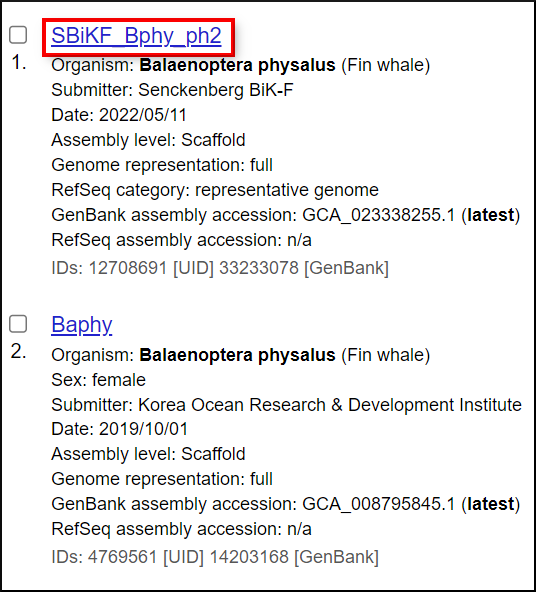

![Genome page for the Fin Whale Assembly, SBiK_Bphy_ph2, with the WGS project accession, JAHXJN01, highlighted](attachment:aca93616-d980-4e3d-af2b-902f896f1c17.png "Fin Whale Assembly Record")
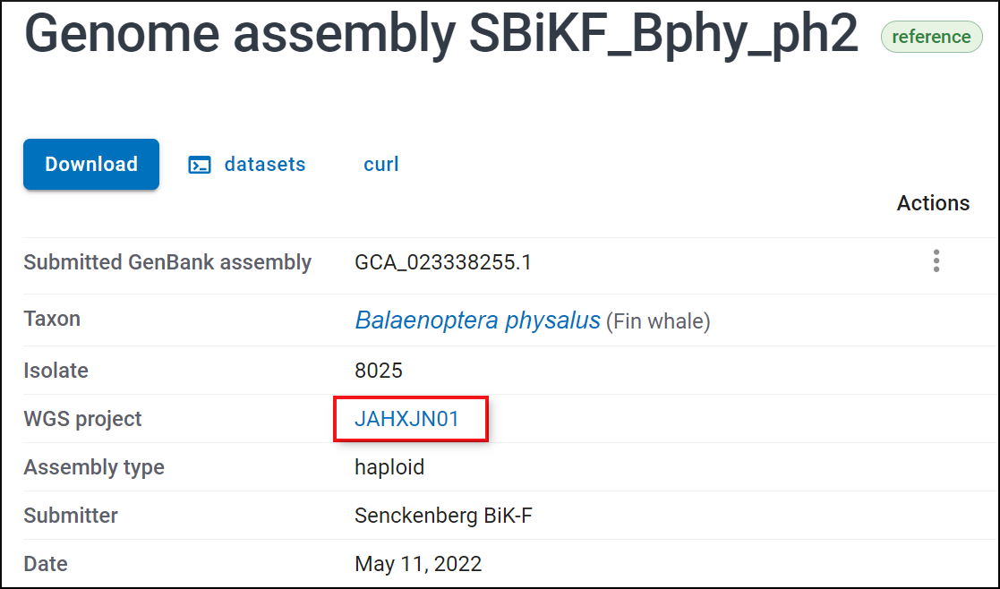

 We can use a specialized version of BLAST (blastn_vdn) to search WGS over the internet to find the contig that contains the match to the blue whale myoglobin. Simply use the WGS id as the argument for db.  
 
The following command will find the the contig that contains the MB gene.

In [ ]:
blastn_vdb -query whale_mb.fna -db JAHXJN01 -outfmt 7 -num_threads 4

All of the hits are to one sequence, JAHXJN010000009.1, which we will use as the database for our MagicBLAST alignments. This is a 75 million base pair contig. We'll use only a 2 million base pair portion centered around the myoglobin match. We can specify -seq_start and -seq_stop in efetch to get the region we want.   

As in the first example, we'll use makeblastdb to generate a BLAST database.  We can save a step by piping the output of efetch directly to makeblastdb. 

In [ ]:
efetch -db nuccore -format fasta -id JAHXJN010000009.1 -seq_start 63000000 -seq_stop 64000000 | \
makeblastdb -dbtype nucl -parse_seqids -out fin_whale_contig -title 'JAHXJN010000009.1 Fin Whale 2Mbp MB Contig'

### Step 2. Collection RefSeq mRNAs for the Blue Whale to align to the Fin Whale contig.   
The Gene database has information about the annotated genes for blue whale. To limit the scope of our search, we'll use only transcripts from genes on chromosome 10 near the MB gene. We should be able to annotate the closely related Fin Whale contig with these gene products. The following search in the Gene database will find protein coding genes on Blue Whale chromosome 10 in the vicinity of the MB gene.  
["blue whale"[organism] AND "genetype protein coding"[properties] AND 10[chromosome] AND 90433000:92889000[chrpos]](https://www.ncbi.nlm.nih.gov/gene/?term=%22blue+whale%22%5BOrganism%5D+AND+%22genetype+protein+coding%22%5BProperties%5D+AND+10%5Bchromosome%5D+AND+90433000%3A92889000%5Bchrpos%5D).  

![Gene database results for a search for Blue Whale protein coding genes on chromosome 10 in the range 90433000-92889000. The myglobin gene is highlighted.](attachment:855406df-39c0-4b94-b2da-608d0dd41732.png "Blue Whale Genes on Chromosome 10 near the Myoglobin Gene")


We can do the same search using EDirect's esearch. The following command will post the results of the search to the Entrez History server.
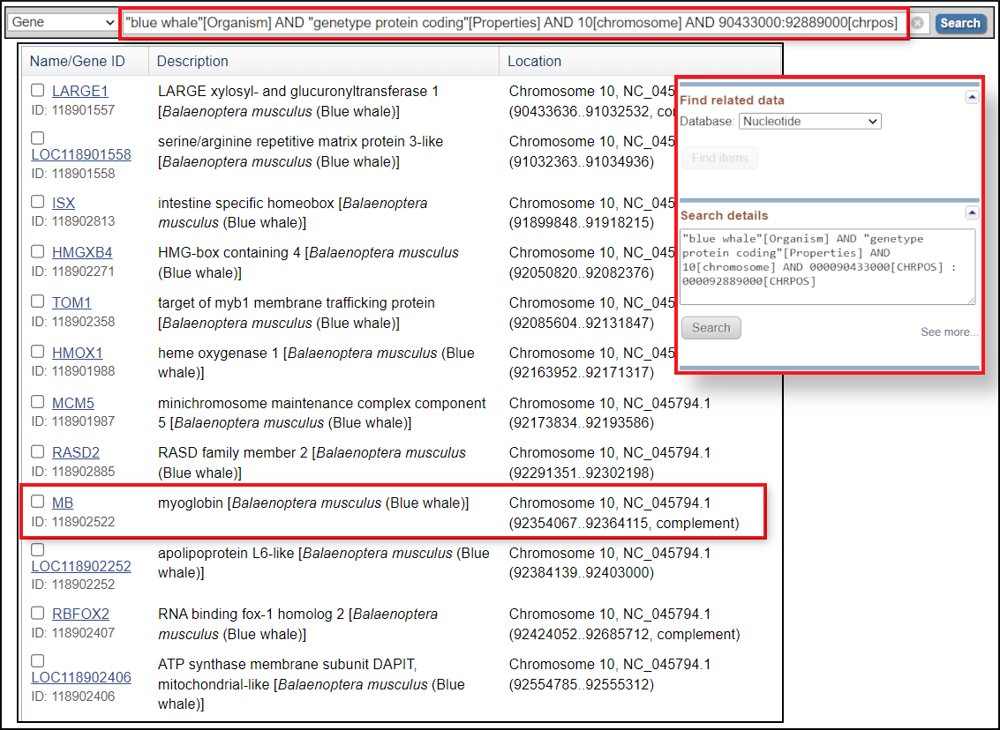

In [ ]:
esearch -db gene -query '"blue whale"[Organism] AND "genetype protein coding"[Properties] AND 10[chromosome] AND 90433000:92889000[chrpos]'

We can use these results, which are stored in the NCBI Entrez History Server, and EDirect's elink script to link to the the corresponding RefSeq transcripts in the nucleotide database.  Run the following command to get the set of RefSeq protein-coding transcripts.

In [ ]:
esearch -db gene -query '"blue whale"[Organism] AND "genetype protein coding"[Properties] AND 10[chromosome] AND 90433000:92889000[chrpos]' | \
elink -target nuccore -name gene_nuccore_refseqrna | \
efetch -format fasta > blue_whale_rna.fna
grep '>' blue_whale_rna.fna

In [ ]:
# Download Link in case the above code does not run or is taking a long time: 
curl 'https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/blue_whale_rna.fna' --output blue_whale_rna.fna

### Step 3. Aligining Blue Whale transcripts to the Fin Whale contig.

Run the following MagicBLAST command to align the transcripts to the contig and get the MagicBLAST tab-delimited output.


In [ ]:
magicblast -query blue_whale_rna.fna  -infmt fasta -splice T -limit_lookup T -no_unaligned -perc_identity 96.0 -db fin_whale_contig -num_threads 4 -outfmt tabular -out blue_whale_fin_whale_out.tab
ls -l | grep blue_whale_fin_whale_out.tab

The MagicBLAST tabular output is [described on the GitHub page](https://ncbi.github.io/magicblast/doc/output.html). It's simpler than the SAM format and a little more human readable. Use the command below to dump out the tab format. Notice that the the accession number of the query sequence is in the first column. The reference is in the second column. The position of the matches on the reference are in the 9th and 10th columns.

In [ ]:
#Getting a listing of the MagiBLAST output
cat blue_whale_fin_whale_out.tab

A shorthand rendering of the alignment called the BTOP string is in column 17.  Use the following command-line to get the BTOP string for the myglobin alignments. The blue whale myoglobin accession is XM_036866958.1.

In [ ]:
#Examining the BTOP string for myoglobin
grep XM_036866958.1 blue_whale_fin_whale_out.tab | cut -f 17

The BTOP string shows the following information:
- a number represents a number of matches
- two bases represent a mismatch and show query and reference base
- base and gap or gap and base, show a gap in query or reference
- ^\<number>^ represents an intron of this number of bases
- \_\<number>_ represents an insertion (gap in reference) of this number of bases
- %\<number>% represents a deletion (gap in read) of this number of bases
- (\<number>) shows number of query bases that are shared between two parts of a spliced alignment; used when proper splice sites were not found  

 14CT76GC15GC69%5610%222^gt3435ag^46GC177TC120GA144CG13TC54CA46TC23TC58  

In this case the string shows three distinct regions of matches (three exons) with some mismatches, interrupted by two possible introns. The second intron has a consensus splice site at either end. We'd need to examine the genomic sequence in this region to see if missing data caused the missed splice site for the first intron. This three exon structure is consistent with that of other myoglobin genes.  

We can sort the ouput on the subject start position using the Unix sort utility and output the accessions and their positions on the contig.  

Note: The grep command at the beginning removes the header comment lines from the output before sorting.

In [ ]:
#Sorting by position and listing matches by position on the contig
grep -v '^#' blue_whale_fin_whale_out.tab | sort -k 9 -n | cut -f 1,9,10


Finally, we can submit each of the accessions in order to efetch to get the names of the gene products.

In [ ]:
#Using efetch to get gene product name
grep -v '^#' blue_whale_fin_whale_out.tab | sort -k 9 -n | cut -f 1 | \
while IFS= read -r line; do
    efetch -db nuccore -id "$line" -format fasta | grep '>'
done

As expected, this gene order matches that on the blue whale chromosome 10. The blue whale myoglobin gene is boxed in red in the graphic below. You can access this [view in the Genome Data Viewer](https://www.ncbi.nlm.nih.gov/genome/gdv/browser/genome/?id=GCF_009873245.2&chr=NC_045794.1&from=91941074&to=92777105), which we'll use in the next section. 

![A graphical view of Blue Whale chromosome 10 showing graphic bars indicating genes in the myoglobin (MB) region, The gene order is ISX, HMGXB4, TOM1, HMOX1, MCM5, RASD2, MB, DAPIT, RBFOX2](attachment:e8c229a0-2604-43b2-a77e-e0066d086eab.png "Graphical View of Genes on Blue Whale Chromosome 10")

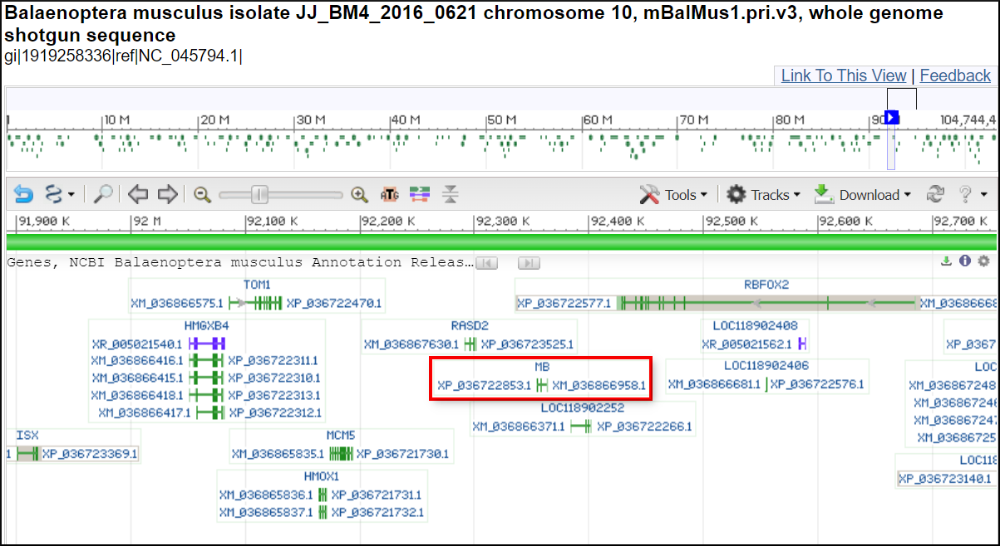

## On your own examples  

You can click on the three dots ... to reveal the answer.  Just remove the \#'s on the revealed cell to run the code.  
**Answers also available [here](https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/magicblast_pt1_exercises_answers.txt).**

### Practice Example 1. Aligning ebolavirus reads from a recent outbreak to the Zaire ebola virus genome Reference genome. 

Zaire Ebola virus Yambuku-Mayinga strain Reference genome sequence: [NC_002549](https://www.ncbi.nlm.nih.gov/nuccore/NC_002549.1)  

Ebola virus next-gen reads from the 2014 outbreak in Sierra-Leon: [SRR1553459](https://www.ncbi.nlm.nih.gov/sra/?term=SRR1553459)



In [ ]:
# Use efetch to retrieve the Ebola virus Reference genome sequence.

In [ ]:
#efetch -db nuccore -id NC_002549 -format fasta > NC_002549.fna
#head NC_002549.fna

In [ ]:
# Use makeblastdb to format the genome as a BLAST database.

In [ ]:
#makeblastdb -in NC_002549.fna -dbtype nucl -parse_seqids -out NC_002549

In [ ]:
# Use magicblast to align the reads. Output a sam file SRR1553459.sam

In [ ]:
#magicblast -sra SRR1553459 -db NC_002549 -splice F -limit_lookup F -paired -no_unaligned -num_threads 4 -outfmt sam -out SRR1553459.sam
#head SRR1553459.sam

In [ ]:
# Use samtools to generate a sorted BAM file SRR1553459_sorted.bam

In [ ]:
#samtools view -bS SRR1553459.sam | samtools sort -o SRR1553459_sorted.bam -O BAM
#ls -l | grep SRR1553459_sorted.bam

In [ ]:
# Use samtools to create a BAM index file SRR1553459_sorted.bam.bai

In [ ]:
#samtools index SRR1553459_sorted.bam SRR1553459_sorted.bam.bai
#ls -l | grep SRR12348966_sorted.bam.bai

Both the sorted BAM and BAM index are on the FTP site. Load the [graphics view of NC_002549](https://www.ncbi.nlm.nih.gov/nuccore/NC_002549.1?report=graph) and add the remote BAM file using  

`https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2023/NextGenMagicBlast_Oct/SRR1553459_sorted.bam`

Jump to position 7,029 in the genome. This variation actually affects the sequence of two different protein products, the **spike-glycoprotein** and the **secreted glycoprotein**. Two products are produced because a base is inserted during transcription causing a frameshift and a second protein product.   

What amino acid changes are predicted for each protein? You can refer to the [standard genetic code chart](https://www.ncbi.nlm.nih.gov/Taxonomy/taxonomyhome.html/index.cgi?chapter=cgencodes#SG1) in NCBI's Taxonomy to help with translation.

Position 7,029 in the Reference ebola Mayinga genome has a G base and is part of the GGG codon for glycine (G) in the spike glycoprotein. The Sierra Leon sample has an A base in this position changing the glycine codon to a glutamate (E) codon.   

For the secreted glycoprotein the codon in the Reference genome is a GGA codon, also glycine (G). The A base substitution in the Sierra Leon sample changes this to an AGA codon for arginine (R). 

> `GGG -> GAG    Gly(G) -> Glu(E) ebola spike glycoprotein`  
> `GGA -> AGA    Gly(G) -> Arg(R) secreted glycoprotein`

These are two very different strains of ebolavirus and there are a large number of base changes between them.

## \[Optional\] Practice Example 2. Annotating the Blue Whale tumor necrosis factor (TNF) gene region on the N. Pacific Right Whale (_Eubalaena japonica_)  



In [ ]:
# Use esearch and efetch to download the Blue Whale TNF mRNA 
# as whale_tnf.fna
# Use TNF[gene] AND blue whale[organism] AND mrna[filter] AND refseq[filter] as a query.

In [ ]:
#esearch -db nuccore -query 'TNF[gene] AND blue whale[organism] AND mrna[filter] AND refseq[filter]' | \
#efetch -format fasta > whale_tnf_mrna.fna
#head -100 whale_tnf_mrna.fna

Use the [Assembly web resource](https://www.ncbi.nlm.nih.gov/assembly/) to get the WGS project ID for Eubalena japonica. 

In [ ]:
# Use blastn_vdb, the Right Whale TNF mRNA (whale_tnf.fna), 
# and the Eubalaena japonica WGS project to find an E. japonica
# contig with the TNF gene. 

Search https://www.ncbi.nlm.nih.gov/assembly/ with Eubalaena japonica[organism].  
There is only one assembly https://www.ncbi.nlm.nih.gov/datasets/genome/GCA_004363455.1/  
The WGS project is on the page: **RJWP01**

In [ ]:
#blastn_vdb -db RJWP01 -query whale_tnf_mrna.fna -outfmt 7

In [ ]:
# Use efetch and makeblastdb to generate a BLAST database
# from the Eubalaena japonica contig found above. 
# Note: This contig is only 167Kb, so you can download the whole thing.

In [ ]:
#efetch -db nuccore -id RJWP010000557.1 -format fasta | \
#makeblastdb -dbtype nucl -parse_seqids -out np_right_whale_contig -title 'RJWP010000557.1 N. Pacific Right Whale TNF Contig'

In [ ]:
# Use esearch, elink, and efetch to get the protein coding gene 
# transcripts from Blue Whale chromosome 11
# TNF is on Blue Whale chromosome 11.
# Save as blue_whale_chr11_mrna.fna.

In [ ]:
#esearch -db gene -query '"blue whale"[Organism] AND "genetype protein coding"[Properties] AND 11[chromosome] AND 23513386:23549925[chrpos]' | \
#elink -target nuccore -name gene_nuccore_refseqrna | \
#efetch -format fasta > blue_whale_chr11_mrna.fna
#grep '>' blue_whale_chr11_mrna.fna

In [ ]:
# Use magicblast to align the transcripts to the Eubalaena japonica contig.

In [ ]:
#magicblast -query blue_whale_chr11_mrna.fna  -infmt fasta -splice T -limit_lookup T -no_unaligned -perc_identity 96.0 -db np_right_whale_contig -num_threads 4 -outfmt tabular -out blue_whale_right_whale_out.tab
#cat blue_whale_right_whale_out.tab

In [ ]:
# Finding BTOP string for TNF, XM_036869256

In [ ]:
#grep -v '^#' blue_whale_right_whale_out.tab | grep XM_036869256 | cut -f 17

Compare to the [structure of the human TNF gene](https://www.ncbi.nlm.nih.gov/nuccore/NG_007462.1?from=4576&to=8179&report=graph&content=5).


`137GC187^gt579ag^46^gt185ag^12AC35^gt323ag^157TC383GA36AG56AG26TG28GC53CT224TC4AG212`  

The BTOP string is consistent with four exons with three introns as in human. The BTOP string shows splice signals flanking the three introns (579 bp, 185bp, 323bp). There are more mismatches than in the blue whale vs. fin whale myoglobin example because the right whale is a more distant relative of blue whale than the fin whale is.

In [ ]:
# Use Unix utilities to sort the output and print out the accessions
# for the transcript matches.

In [ ]:
#grep -v '^#' blue_whale_right_whale_out.tab | sort -k 9 -n | cut -f 1,9,10

In [ ]:
# Use Unix utilities and efetch to print out the gene products in order.

In [ ]:
#grep -v '^#' blue_whale_right_whale_out.tab | sort -k 9 -n | cut -f 1 | \
#while IFS= read -r line; do
#    efetch -db nuccore -id "$line" -format fasta | grep '>'
#done

---
​
## Objective 3 - Align RNAseq data to reference and visualize transcript coverage and diversity <a class="anchor" id="Objective-3"></a>
​
**Case Study for Objective 3**: Lamin-A Gene Mutations/Splice Variants and their role in diseases 
​
### **Objective Goals**
​
* Identify an RNAseq SRA dataset of interest in the Gene Expression Omnibus
* Use magic-BLAST to align SRA dataset to a reference. 
* Learn how to upload a remote file to GDV. 
* Use the Genome Data Viewer to compare RNAseq alignment to NCBI annotation tracks.
​
## Overview: 
* Hutchinson-Gilford progeria syndrome (HGPS) is a rare genetic disorder phenotypically characterized by many features of premature aging. 
* Mutations causing HGPS have been identified in the nuclear lamin A/C (LMNA) gene. Out of 14 mutations affecting lamin A/C, three have been reported to specifically alter lamin A splicing.Most are due to a recurrent, de novo point mutation in LMNA exon 11: c.1824C>T. This mutation occurs in a probable exon splicing enhancer. As a result, a cryptic splice site is activated in transcripts generated from the mutated allele, which is located 5 nucleotides upstream of the mutation.
*  The use of the cryptic splice site leads to the production of a truncated Lamin A protein lacking the last 150 base pairs of exon 11. The truncated protein is called “progerin” and acts in a dominant fashion to generate the HGPS phenotype.
* LMNA gene mutations also cause a number of diseases, so could be a really interesting genomic region to study: https://www.omim.org/entry/150330

### **Goal 3a: Identify an RNAseq SRA dataset of interest**


We are going to be getting NGS data generated by a publication: https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0205878

<div>
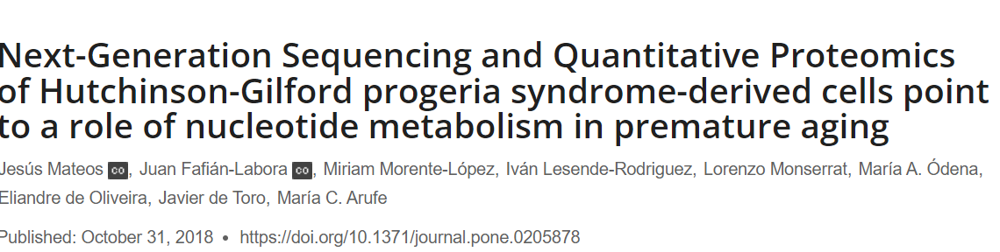
</div>

To quote this paper: 

> Although the causal agent, a point mutation in LMNA gene, was identified more than a decade ago, the molecular mechanisms underlying HGPS are still not fully understood and, currently, there is no cure for the patients, which die at a mean age of thirteen. With the aim of unraveling non-previously altered molecular pathways in the premature aging process, **human cell lines from HGPS patients and from healthy parental controls were studied in parallel using Next-Generation Sequencing (RNAseq) and High-Resolution Quantitative Proteomics (iTRAQ) techniques**



**Step 1: Find identifying information for a dataset** 

Luckily for us, scrolling down to the Results section, we can see that the authors have linked to their study data on the NCBI Gene Expression Omnibus (GEO) under accession number GSE113648: 

>Raw files are public and freely accessible (www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE113648). A total of 21872 transcripts were detected and quantified in both conditions (Control and HGPS) by NGS following our approach (S1 File and Fig 2A).

Click the link in the quoted text to take a look at the study on GEO!

**Step 2: Get SRA Run info from chosen study** 

Step A. Find the link to the SRA Run Selector 

While there is a lot of useful information on this webpage about the study. For today, we are going to simply scroll right to the bottom of the page and find the link directly to the `SRA Run Selector` table for this study: 

<div>
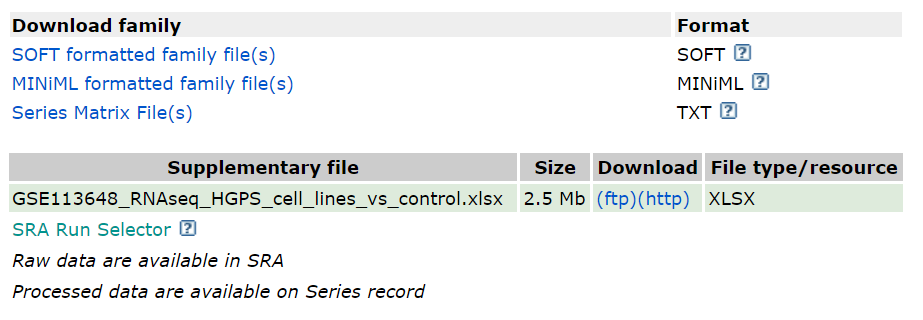
</div>

Clicking this link will take you to the SRA Run page for the BioProject corresponding to this GEO dataset: https://www.ncbi.nlm.nih.gov/Traces/study/?acc=PRJNA453535&o=acc_s%3Aa

Step B:  Look at the SRA Run Selector

Once again, we could spend a while looking at this webpage, but for the purposes of this study, we are interested in the table at the bottom, that gives us information about each SRA run under this BioProject. Notably it is easy to see which samples have the progeria diease genotype (HGPS), and which ones are : 


<div>
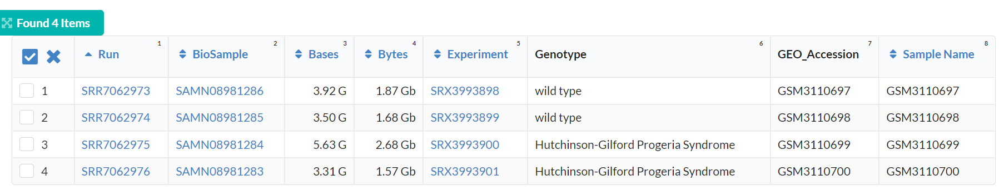
</div>

For the purposes of our study today we are going to pick the first Wild Type Sample, `SRR7062973`, and the first with Hutchinson-Gilford Progeria Syndrome, `SRR7062975`. 

### **Goal 3b: Use magic-BLAST to align chosen SRAs to reference sequence**

Above, we identified two RNAseq SRA data sets we would like to map to the region of the human genome containing the LMNA gene: SRR7062973 (our control sample), and SRR7062975 (our HGPS sample). 

**Step 1: Download the region of the current human genome assembly containing the LMNA gene**

Looking at the Gene Page for the LMNA gene, we can see that the LMNA gene occupies base pairs 156082573 to 156140081 on Human Chromosome 1. Because we want to learn about the genes in the surrounding region as well, we are going to extract the entire Human Chromosome 1 into a FASTA file. The following `efetch` command will extract the sequence for Human Chromosome 1 into a FASTA-formatted file. 

In [ ]:
efetch -db nuccore -id NC_000001 -format fasta > Human_Chromosome1.fasta

This command will not report that it is done, but in a few seconds, the file `Human_Chromosome1.fasta` should appear amongst the list of files in your left panel: 

<div>
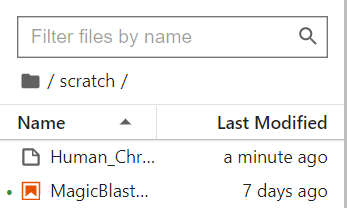
</div>


We can also use a Bash `head` command to confirm that this is a FASTA-formatted file:  

In [ ]:
head -n 5 Human_Chromosome1.fasta

**Step 2: Create LMNA region BLAST database**

Now that we have the region downloaded in FASTA format, we can use the BLAST utility `makeblastdb` to create a BLAST-formatted database from the file, using the following command. This command should produce text output that begins with `Building a new DB...` nearly immediately, and you should see 10 files appear in your left panel. These files are all parts of the Blast database we just created. 

In [ ]:
makeblastdb -in Human_Chromosome1.fasta -out Human_Chromosome1 -parse_seqids -dbtype nucl

**Step 3: Run magic-BLAST! Or, really, I will run it for us...**

Now that we have identified the SRA numbers of the sequencing runs we are interested in, and created a BLAST database for Human Chromosome 1, we are ready to use magic-BLAST! In reality, these are commands would take up to three hours to run, even with multiple processors. 

So, I have run the following commands for us on a computing cluster, and placed them on an FTP server. I will later be showing you how to stream the result files directly into GDV so we don't need to store the large result files anywhere locally: 

* **Step 3a: Run magic-BLAST and convert results to BAM for the control sample:**

You **DO NOT** need to run these commands!  

In [ ]:
# DO NOT RUN THIS COMMAND
magicblast -sra SRR7062973 -db Human_Chromosome1 -num_threads 16 -no_unaligned -out Chr1_LMNA_SRR7062973.sam

In order to examine patterns of gene expression in GDV, we will want our output in a BAM file so they can be visualized as a Pileup track. Streaming a file into GDV via an FTP site requires there to be a BAM index file, a `.bai` file, in the same location as the BAM file itself, so we will convert the magic-BLAST SAM output to BAM, and then index it using the following commands. 

Again, you **DO NOT** need to run these commands!

In [ ]:
# DO NOT RUN THESE COMMANDS
samtools view -S -b Chr1_LMNA_SRR7062973.sam > Chr1_LMNA_SRR7062973.bam
samtools sort Chr1_LMNA_SRR7062973.bam -o Chr1_LMNA_SRR7062973.sorted.bam
samtools index Chr1_LMNA_SRR7062973.sorted.bam

* **Step 3b: Run magic-BLAST and convert results to BAM for the HGSP sample:**

You **DO NOT** need to run these commands! 



In [ ]:
# DO NOT RUN THIS COMMAND
magicblast -sra SRR7062975 -db Human_Chromosome1 -num_threads 16 -no_unaligned -out Chr1_LMNA_SRR7062975.sam

As mentioned before, I have already placed the relevant sorted BAM files and their indices on an NCBI FTP site, so they are all ready to go!

### **Goal 3c: Load magic-BLAST results into GDV from a remote source**

**Step 1: Opening GDV onto Chromosome 1**

Let's all navigate to NCBI's Genome Data Viewer: https://www.ncbi.nlm.nih.gov/genome/gdv/. Because we are focusing on Chromosome 1, we will want to open a fresh GDV window focusing just on Chromosome 1. We can go straight to this chromosome by typing "chr1" into the "Search in Genome Box", while leaving the species and Assembly as-is, then press the search button: 

<div>
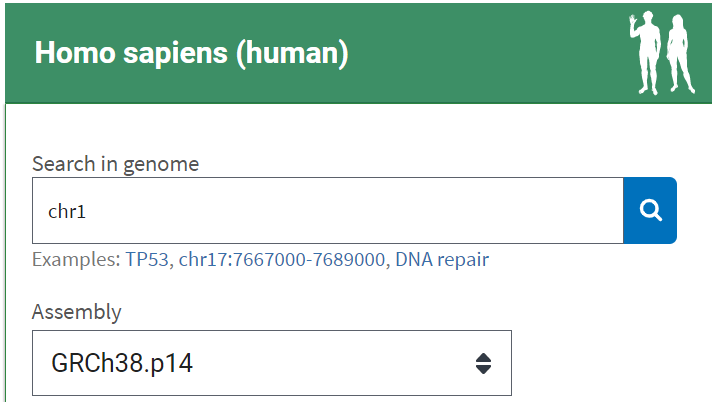
</div>

A GDV instance with Human Chromosome 1 (accession: NC_000001.11) should appear within a few seconds. While the following image is for Chromosome 19 rather than our Chromosome 1, it has all of the same pieces: 

<div>
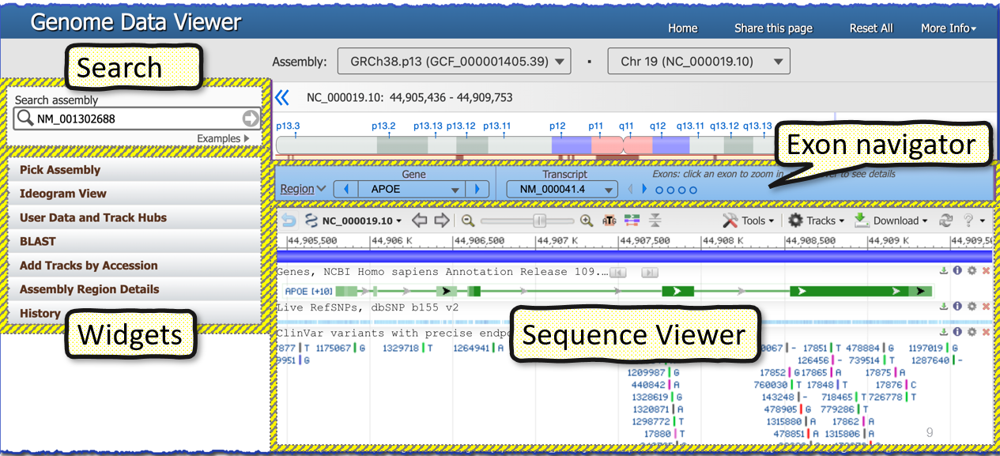
</div>

To reduce clutter while we load our own data, I like to close out all of the tracks besides the main sequence track and the NCBI Genes Annotation track by clicking the red X's in the corner of each track. This should result in a view that looks similar to this: 

<div>
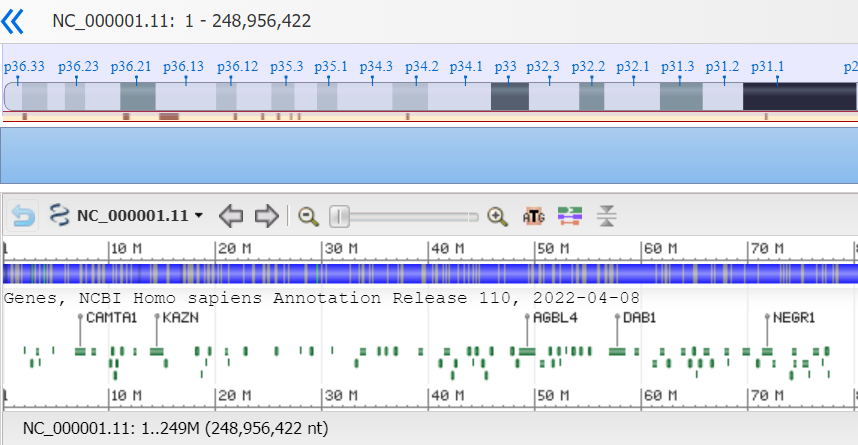
</div>

**Step 2: Add remote BAM file for control sample** 

One of the nicest features of GDV is accessing large, remote alignment files for visualization quickly and without actually needing to transfer these files locally or to GDV itself. Note that different file types can be accepted for Remote File access as compared with local upload: 


<div>
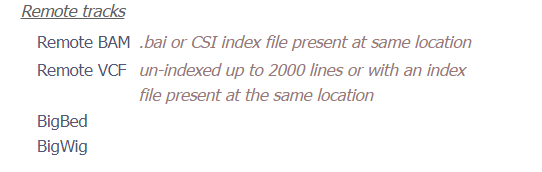
</div>


To do so, we are going back to the **Tracks and User Data** pane (in the Widgets menu), but this time selecting `Add Remote File`: 

<div>
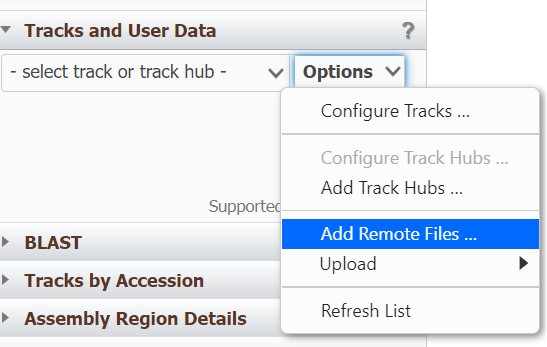
</div>

**Info for uploading:**

A upload window should appear, with a space to type in a URL where the remote file is stored. In this window, create a track with the name **WT_Skin_Fibroblast** and the following URL: 

In [ ]:
https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2023/NextGenMagicBlast_Oct/Chr1_LMNA_SRR7062973.sorted.bam

**Name:** WT_Skin_Fibroblast

The track will be loaded in quite quickly, and you will be able to tell in a number of ways. First, in the `Tracks and User Data Pane` a green checkbox with an `Track(s) Add` confirmation will appear: 

<div>
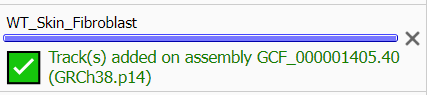
</div>

You will also see the track itself appear in the browser window. Note that BAM files are generally represented in GDV as Coverage data that has been log-2-scaled, rather than defaulting to a feature-focused view: 
<div>
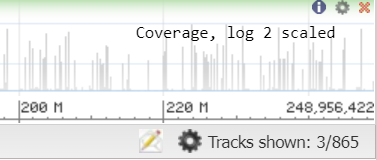
</div>

**On your own, upload the following `HGPS` genotype dataset to GDV with the name HGPS_Skin_Fibroblast:** 

In [ ]:
https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2023/NextGenMagicBlast_Oct/Chr1_LMNA_SRR7062975.sorted.bam

---

### **Goal 3d: View the LMNA gene using different alignment views**

**Step 1: Focus on LMNA Gene** 

Uh oh! We see an alert towards the top of our GDV browser window saying that there are too many genes in the region! No problem - there are many ways to perform a search for the specific region containing our gene of interest. 

1. Simplest: `Search Assembly` window,  type in `LMNA`, and search. 

<div>
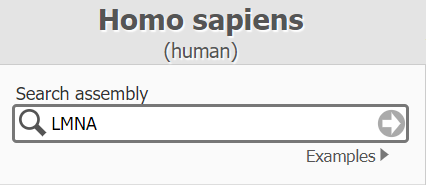
</div>

2. Search by a term: If you don't know the name of the gene you are interested in, you can try searching for a relevant one using other info. In this case, try searching for **"progeria"** in the assembly search box instead. A number of loci will be returned as a result: 

<div>
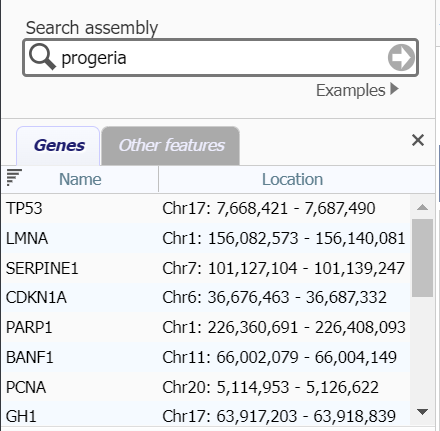
</div>

Hovering over one of these genes provides a preview of the Gene Page info for that gene that may help you decide if this is the gene you are looking for. 

<div>
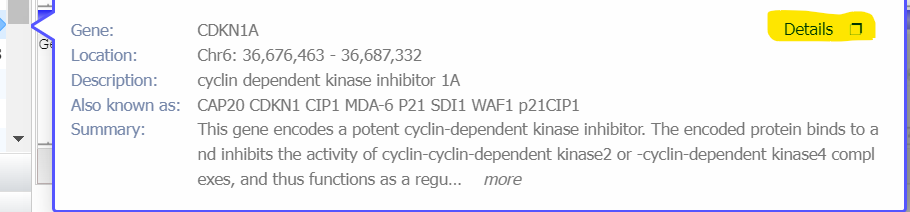
</div>

Clicking on the "Details" link will take you right to the full NCBI gene page for this gene, in this example [CDKN1A](https://www.ncbi.nlm.nih.gov/gene/1026). 

**At this point, you should have used either search method to "focus" on the LMNA gene!**




#### Pause for a question: Does the LMNA gene look differentially expressed to you? Is this expected? 

**Answer**: No, the authors did NOT find that this gene was significantly differentially expressed. Remember, though, that we can keep looking at splice variation...




**Step 2: Navigate around the LMNA gene region to look at expression** 

We are going to momentarily focus on a small difference expression just in one region of the LMNA gene between 156,110K bp and 156,115K bp on Chromosome 1. To keep track of this selection when we zoom in, we can place a marker over this whole region by dragging the cursor along the top bar, then using the Right Click menu option `Set New Marker on Selected Range`. If this works, your image should now look something like this, and there is a lot of information you can get by clicking on `Marker 1`. 

<div>
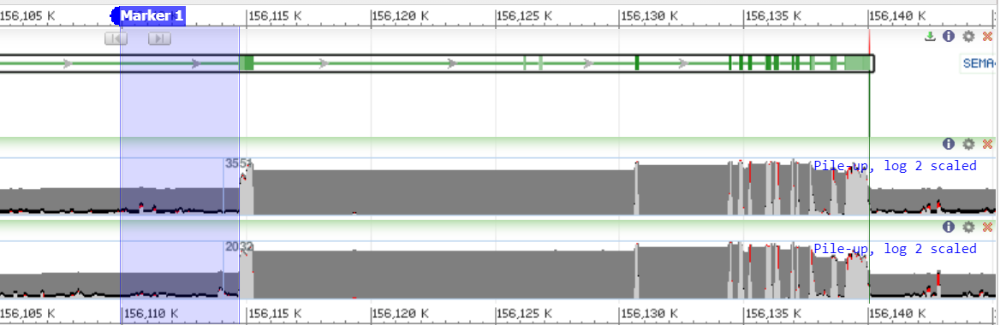
</div>

**Note about viewing alignments on GDV:**

Now that we have a handle on the region that are interested in, we can zoom in using the slider in the "Exon Navigator". Depending on the type of track, there are different options for how your data will be displayed. There are several options for an Alignment Track (such as a BAM), set by changing the Alignment Display options: 

* **Adaptive (default)**:  Alignment data is represented differently at different zoom levels.
* **Packed**: Always shows the coverage or pile-up view
* **Ladder**: One alignment per row 
* **Show all**: Always shows individual alignments.

These can be accessed by going to `Tracks -> Configure Tracks -> Available Tracks`. 


Let's click the little plus-sign magnifying glass on the "Exon Navigator Track" several times until we can see a view which allows us to see individual reads. This is A LOT data at once, so for **EACH** of our uploaded tracks, we are going to clean up a bit by hiding all duplicate and low-quality reads by using the **Configure Track** menu, accessed by either the widget menu or the drop-down menu for the tracks themselves: 

<div>
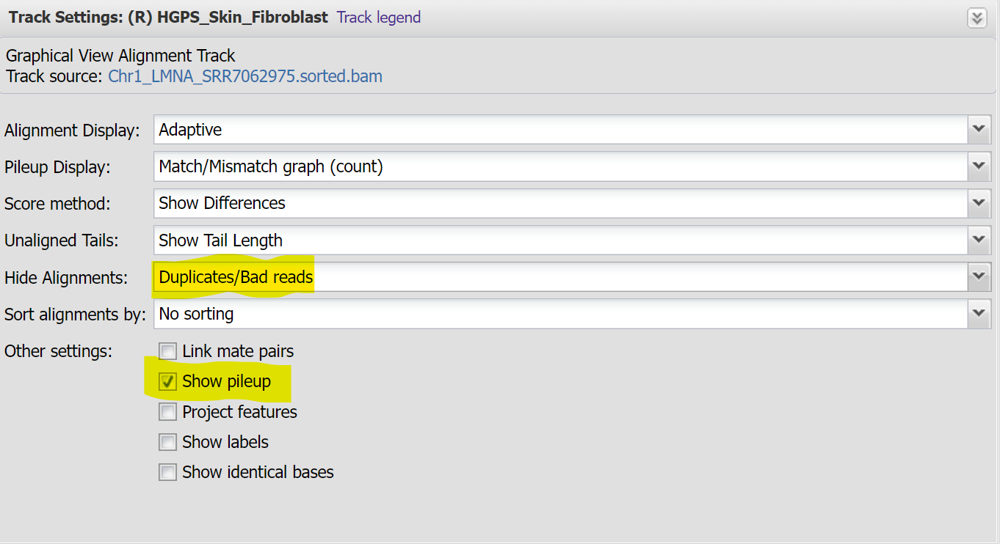
</div>

This is what my view looks like after adjusting those settings: 

<div>
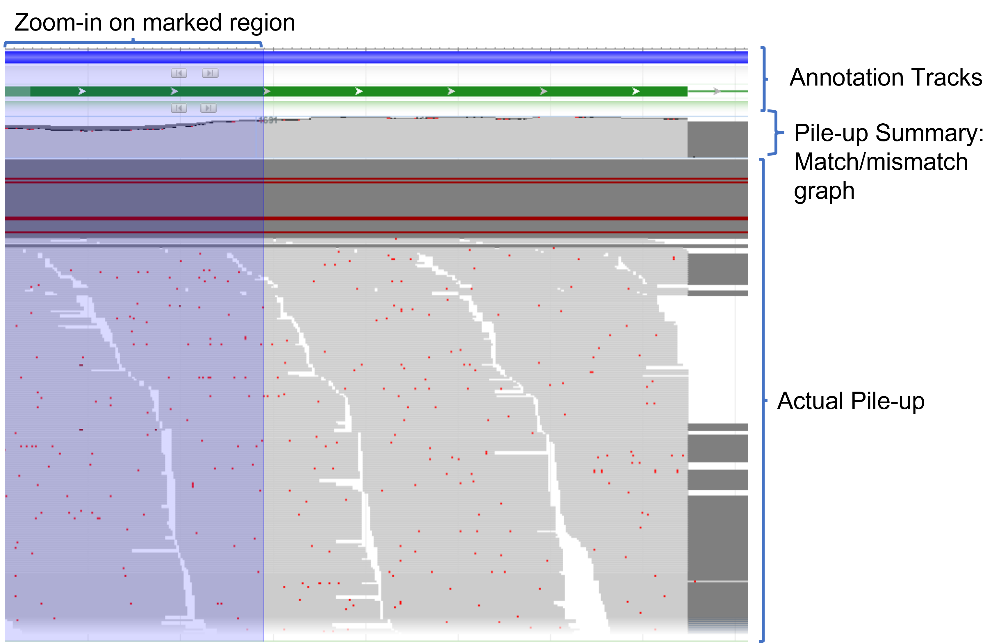
</div>

Because we are in adaptive mode, when we zoom in even further, we go into **Feature View** mode, where you can learn even more about individual sequences and their alignment. Here is a small sample of what this looks like: 

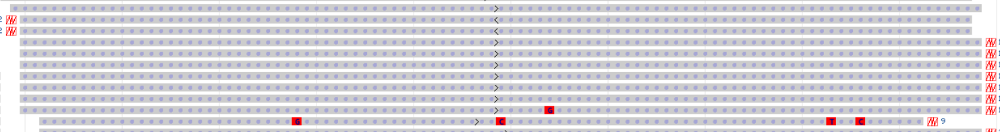

You can access a full legend of the Pile-Up and Feature Views [here](https://www.ncbi.nlm.nih.gov/tools/sviewer/legends/#anchor_7), but to summarize this view: 
> At high zoom levels, alignment details become apparent. By default, matched bases and introns are colored in grey, mismatches and gaps are colored in red, and insertions are represented by blue bars (at higher zoom levels) or a blue hourglass with vertical blue bars proportional to the number of inserted bases. Less-than or greater-than signs (< or >) indicate the orientation of the alignment relative to the assembly.

**Check out the alignment view Tooltip menu for an individual sequence** : 

Once of the coolest parts of the GDV is the wealth of information available about each sequence in an alignment or mapping result. Let's hover over an invidual sequence to see what we can learn: 

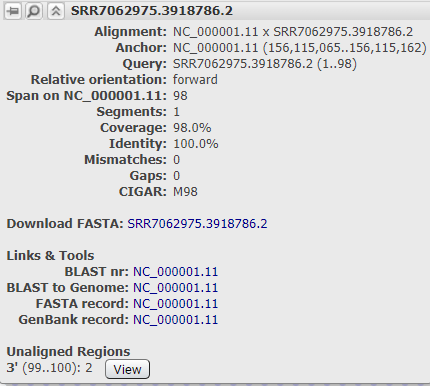

Just to highlight two particularly useful pieces of info we can gather from this menu: 
* **CIGAR**: This is a copy of the CIGAR information pulled from the BAM file for this particular sequence. In short, the CIGAR string contains info about sequence lengths and whether any operations had to be performed to get that sequence to align to the reference (i.e. insertions and deletions). 
* **Download FASTA**: Just as it sounds like, this option downloads a FASTA file of the input aligned short-read sequence. This could be useful to gather sequences with a particular variant, look at sequencing error/adapter contamination, or running any other downstream analyses that require sequence data. 



**Step 2: Use Exon Navigation** 

Let's focus on the **Exon Navigation** bar above the Sequence Viewer window. 

<div>
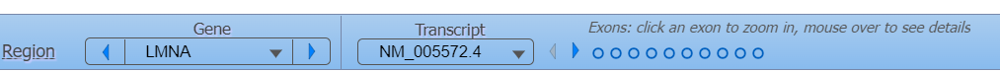
</div>

**The key pieces of information include:** 
* **Gene**: Confirm that we are indeed looking at the correct gene, and navigate on a per-gene basis. 
* **Transcript**: Identifying information about the current NCBI transcript that is highlighted within our view. 
* **Exon**: Each dot represents an exon in the current transcript that we have highlighted. 

**But wait, what about Exon 11???** 

You probably notice that the default transcript representing this sequence by default only has 10 exons! However, we know that one of the mutations that we are interested in actually affects splicing in Exon 11. So, to pick a transcript that will allow us to navigate to and highlight Exon 11 of LMNA, let's choose a transcript that contains all exons of this gene. 

Clicking around in the drop-down **Transcript** menu, we see that transcript `NM_170707.4` (the canonical LMNA transcript) has all twelve expected exons. Pick this transcript, and then go ahead and click on the dot associated with this exon. 

Let's also clean up by switching from the current `Adaptive` alignment display which changes as we zoom in and out, to `Packed` alignment display, which will show just a pileup summary graph no matter if we are looking at the whole exon. Again, this is done from anywhere you can access the `Configure Tracks`. Do this for both of the user-generated tracks.

<div>
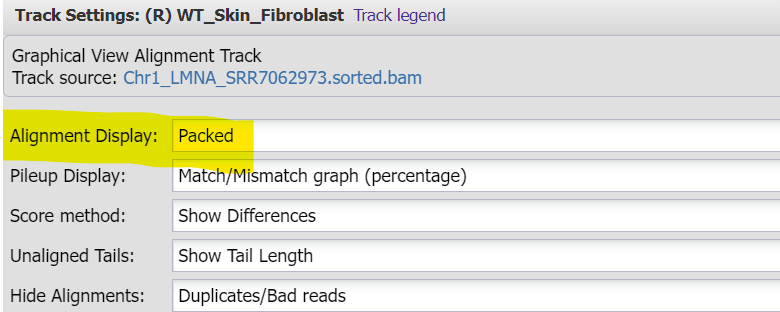
</div>

Now, we can play around with zooming in and out to get a clear comparison of expression patterns in these genotypes:

<div>
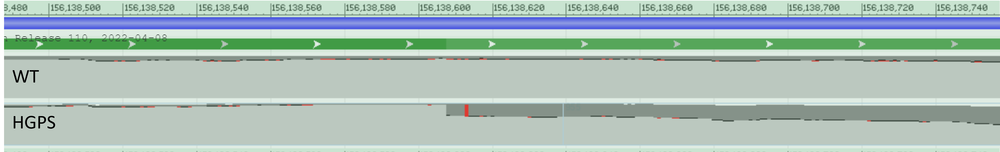
</div>


**What are some differences between Wild Type and HGPS genotypes you notice in this view of LMNA gene Exon 11?** 

**Hint**: Click again on the circle representing Exon 11 in the Exon Navigator bar in order to re-set yourself to the full, default view of this exon. 

### Goal 3e: Examine expression patterns in LMNA Exon 11

**Step 1: Re-setting our view**:

Let's re-center ourselves on the LMNA gene by searching for it again and pressing enter. We can also go ahead and delete the temporary marker we set up to return to a nice, clean view of the whole gene: 

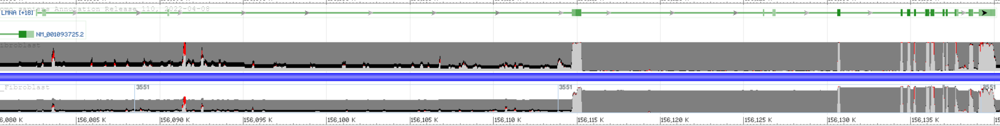

**Step 3: Add RefSeq Expression Data Track for Comparison**

Let's add our first NCBI track for extra information! We are going to use the a `Filtered, Aggregate RNA-Seq Exon Coverage Track` that is part of the `NCBI Homo Sapiens Annotation Release 110`, so part of the official most recent Annotation Release. 

**Follow these steps to find the relevant track** 
* Open your `Tracks and User Data Widget`
* Choose `Configure Tracks`
* Find the `Expression` category on the side bar

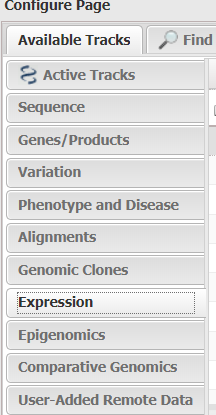

* Scroll down through the available Expression tracks to find `RNAseq Aggregate Tracks` and select the correct option. 

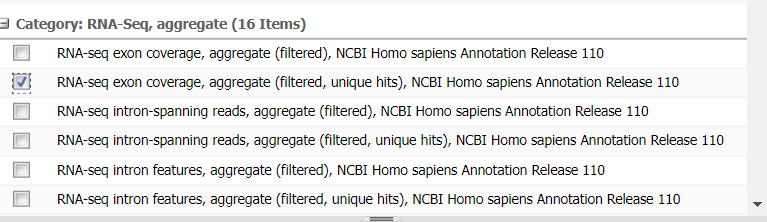

* Click configure, and you should see a view like the one below within a few seconds. 


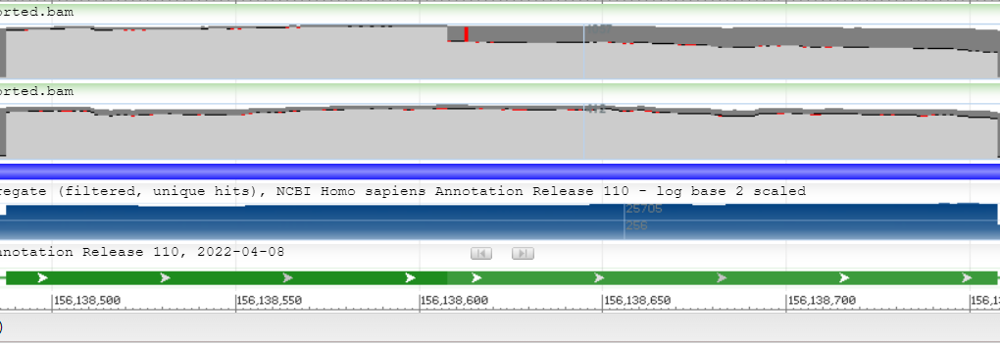


**Step 4: Compare transcript length and diversity between WT and HGPS transcripts and NCBI annotations** 

One thing we noticed right away is that some of the HGPS transcripts covering LMNA Exon 11 appear to have a different structure (they seem shorter) than the Wild Type transcripts covering this same exon. Let's investigate this further. 

Here are some things we can do to explore the HGPS transcripts: 
* Re-enable `Adaptive` alignment view for the HGPS track so we can look at individual transcripts 
* Drag the HGPS track closest to the NCBI Gene track 
* Expand the NCBI Gene track to see more transcripts

It looks like some of the HGPS transcripts mapped to this exon are inferred to have an exon that begins earlier than that in nearly all of the WT transcripts.To expand the gene track to show all available transcripts for a locus, click on the Exon 11 rectangle itself on the Gene tracks. This allows us to hone in on some interesting details: 

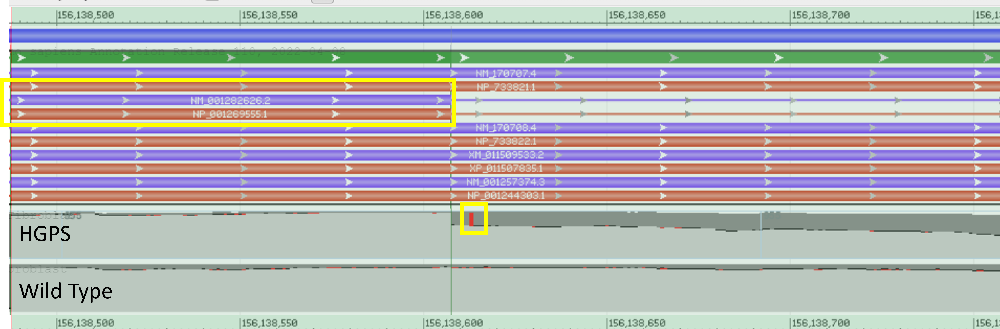

**Do we have progeria-related transcripts in our data set?** 

It looks like there are two transcripts from the NCBI Gene track that have a similar exon structure to those we noticed in the HGPS data set. We are going to find out more about them now. You can hover over each of them to find out a **BUNCH** of potentially useful information about that transcript. Let's take a look at what we can find out by clicking on `GenBank Record` for accession number `NP_001269555.1`. 

<div>
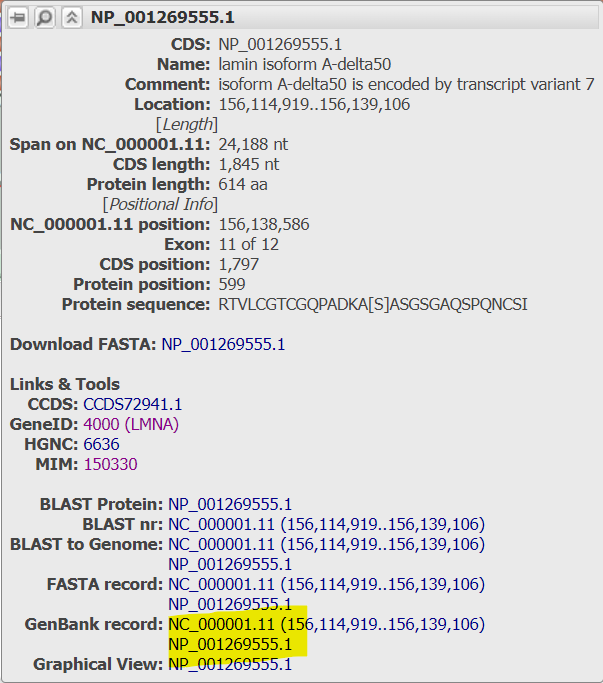
</div>


Clicking on this will take us to the GenPept formatted page for the protein associated with the `NP_001269555.1` identifier. There is a lot to see on this page but we will take a moment to look at the record `COMMENT` section to get a summary : 

<div>
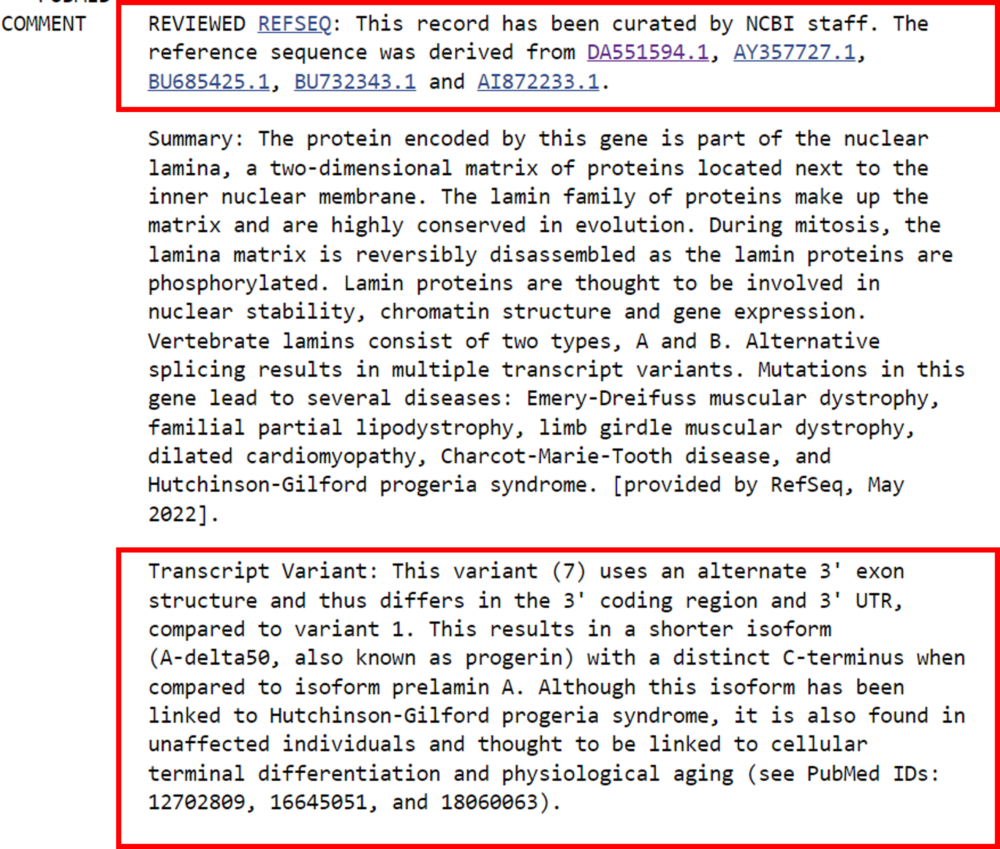
</div>

**Some takeaways here:** 
* Yes, our candidate NCBI transcripts have an alternate exon structure which produces the causative `progerin` version of the LaminA Protein! So, we probably DO have a population of transcripts producing `progerin` in our HGPS data set. 
* This particular record is supported by multiple actual sequence data sets, so we can feel confident about it. 
* With relatively little effort, we have used GDV to identify transcripts of interest in our data set and found related data to help us relate them to our phenotype of interest! 

### Goal 3g: Add additional informational tracks to the view from other sources - ClinVar

Let's shift our focus to other types of data - in this case, nucleotide variation information. We are going to use publicly available data to answer a few more questions about our dataset!

**Finding information about progeria-related genetic variants - Some steps we can take:** 
* Add the tracks with SNP data - have we identified the same progeria variant that previous studies have found? 
* Is there any way we can figure out the global frequency of this causal mutation? 
* What other data can we map onto the LMNA gene to provide extra information? 

**Step 1: Find and display ClinVar variation data tracks**

In short, the mission of NCBI's ClinVar (Clinical Variation) database is to aggregate data related to genomic variation and its relation to human health. Per the [ClinVar website](https://www.ncbi.nlm.nih.gov/clinvar/): 

> ClinVar is a freely accessible, public archive of reports of the relationships among human variations and phenotypes, with supporting evidence. ClinVar thus facilitates access to and communication about the relationships asserted between human variation and observed health status, and the history of that interpretation. ClinVar processes submissions reporting variants found in patient samples, assertions made regarding their clinical significance, information about the submitter, and other supporting data.

For today, we are going to spend most of our time working with a track called `ClinVar variants with precise endpoints`. The data behind this track is a VCF file that is limited to variants in ClinVar that have a precise genomic location. Variants with imprecise start and stop, such as exon deletions and CNVs detected by microarray, are not included in ClinVar's VCF files at this time.

**How to find this track:** 

1. Open the Track Configuration menu
2. Go to the `Find Tracks` tab 
3. Type in `precise` into the search box.
4. In the `Active` column, check off `ClinVar variants with precise endpoints`. 

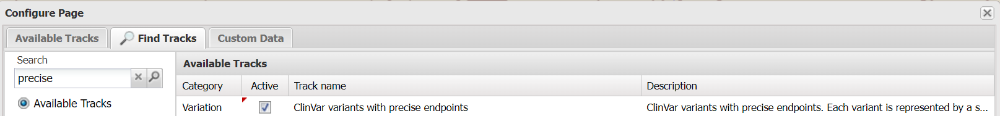

5. Click `Configure` to load the track.

After a moment, you should have a view that looks like this one (give or take based on your level of zoom). There is **A LOT** of information here: 

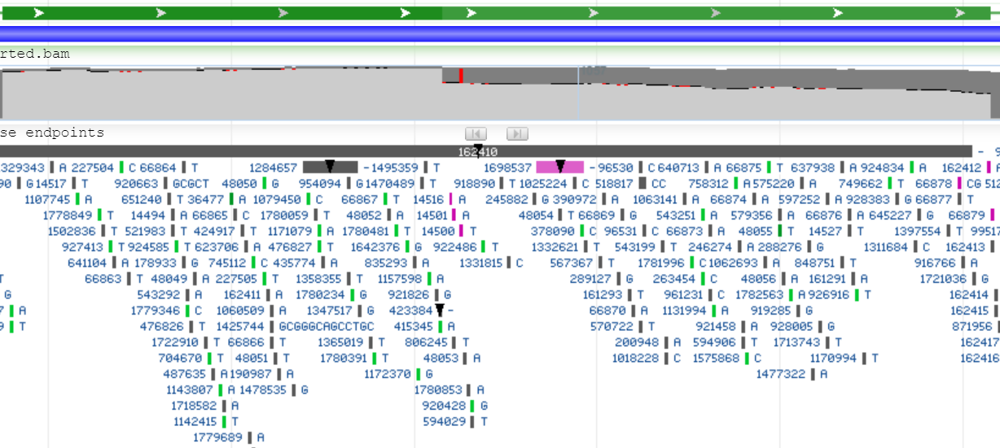

Each piece of information represents a known variant in the ClinVar database. Hovering over one of them will give you even more information about that particular variant in the track, such as the clinical interpretation and molecular consequence : 

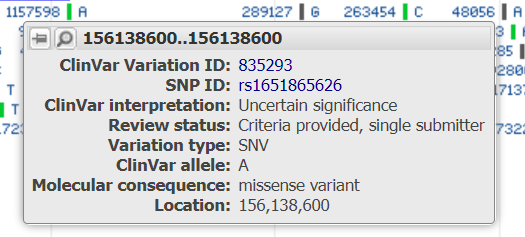

To help you get a handle on the big picture variation present in this LMNA gene, it may help to take a look at the ClinVar variation legend. Since today we are interested in disease phenotypes, we are likely most intereted in dark magenta and pink variants!

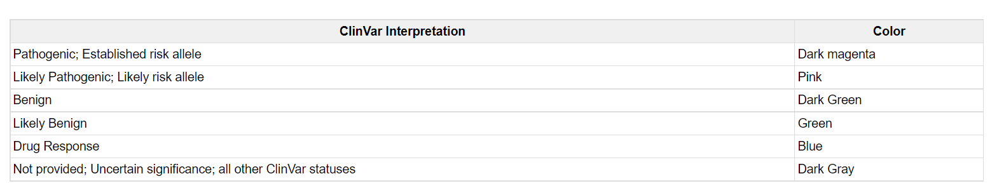

**Step 2: Compare this ClinVar track to variation in our mapped data**

In a previous step, we noticed that at one particular nucleotide, many of our reads that mapped to LMNA Exon 11 had a mismatch with that nucleotide in the human reference genome. Let's see if that corresponds to any variation reported in ClinVar. 

There is one particular variation that appears to be right where our variant is, and is also magenta (meaning pathogenic/established risk allele). Helpfully, if we click on this variant, it draws vertical lines so we can match it with our own data. It appears this variant directly overlaps with variation in our own dataset!

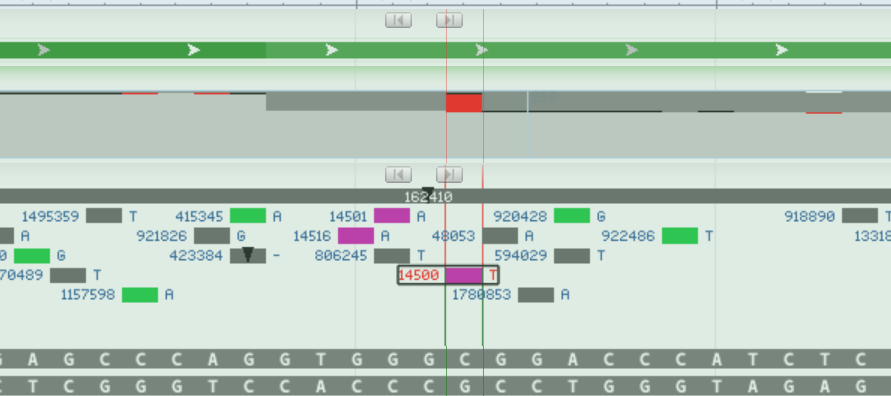. 

Let's hover over this variant to get more information: 


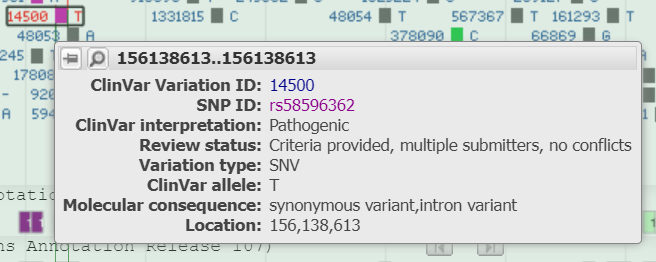

This is a good start, but let's use this menu to answer a few questions. Click on the `ClinVar Variation ID` to go to the ClinVar variant page about [Variant 14500](https://www.ncbi.nlm.nih.gov/clinvar/variation/14500/). 

This page has three major sections of information: Variants, Conditions, and Variant Details: **Is this pathogenic variant related to HGPS?**  

As you might guess, `Conditions` is the best topic to click here. You can see right away that one of the associated `Interpreted Conditions` is indeed Hutchinson-Gilford syndrome, as well as other conditions.

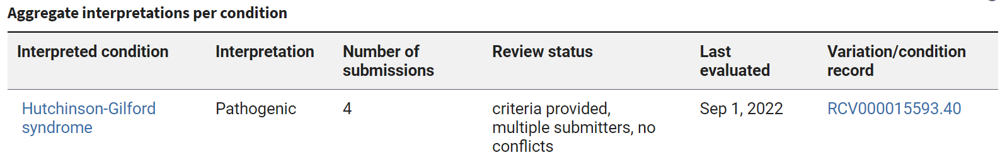

If you scroll down to `Submitted Interpretation and Evidence` and `Citations` you can actually see the relevant evidence submissions and publications. Of note, expanding the first Submitted Interpretation shows us further information relating this variant to the splice variation we discussed in the previous section

> The de novo c.1824C>T variant in the LMNA gene is the cause of classic Hutchinson-Gilford progeria syndrome in approximately 90% of cases (Rodriguez et al., 2009; Lopez-Mejia et al., 2011; Chu et al., 2015; Ericksson et al., 2003). This variant creates a cryptic splice donor site within exon 11 and causes abnormal gene splicing. The c.1824C>T variant was not observed in approximately 6500 individuals of European and African American ancestry in the NHLBI Exome Sequencing Project, indicating it is not a common benign variant in these populations. Functional studies of c.1824C>T indicate that it causes increased expression of abnormal truncated protein during in vitro cell aging (Rodriguez et al., 2009; Lopez-Mejia et al., 2011). The c.1824C>T variant has been classified as a pathogenic variant by other clinical laboratories in ClinVar (Landrum et al., 2014). We interpret c.1824C>T as a pathogenic variant. 

So, this is interpreted to be a rare, pathogenic variation associated with HGPS. **What more can we learn about the frequency of this allele?**  

There are many ways of accessing the SNP page related to this variant, but I will show you how to get this information right from GDV. We are going to hover over the variant of interest again, but click the `SNP ID` this time to get to the **dbSNP** page for this single nucleotide variant. 


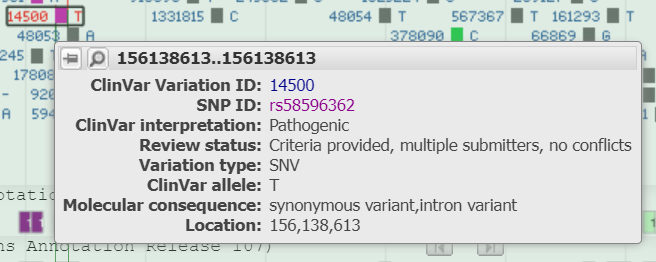

You can confirm with just a little bit of scrolling that this is a very rare variant - present at a frequency of just 0.000008 in the whole [gnomAD Exomes](https://gnomad.broadinstitute.org/), which is the Broad Institute's large aggregated human variation database, and not observed in some population at all! You can easily click on any number of tabs on the page or cells in the tables to link out to so much more information. 

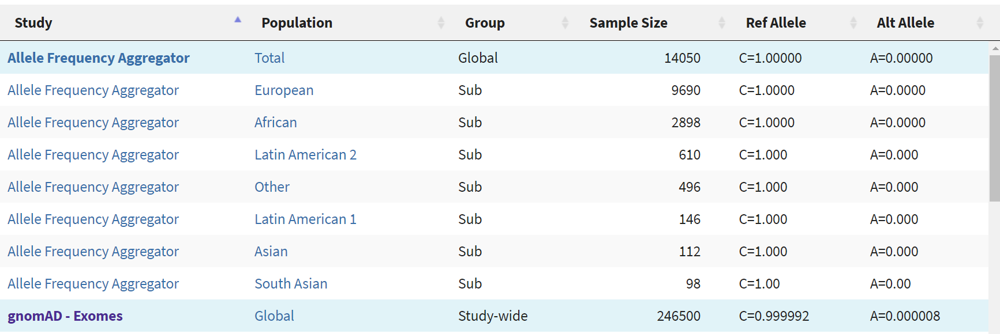


### Goal 3f: Annotating the LMNA gene region on a human pangenome sample 

**Background:** 
As we have just seen in the past examples, the GRCh38 human genome assembly has a huge wealth of associated annotation information. However, a single genome assembly from one sample (no matter how complete) doesn't represent the genetic diversity present amongst humans, which can affect downstream applications such as variant calling. 

To deal with this, the Human Pangenome Reference Consortium is sequencing the human pangenome - a collection of high-quality reference genomes that represent the genetic diversity of the human population. The publication for the pangenome project can be found here: https://pubmed.ncbi.nlm.nih.gov/37165242/. 

We'll use magicBLAST to map complete transcript sequences from the GRCh38 assembly to identify genes on an unannotated genome sequence from the pangenome project.  We'll focus on the region surrounding the LMNA gene. 

**About our sample**: 
The genome we will be annotating is from the [WGS shotgun genome sequencing project JAHAON01](https://www.ncbi.nlm.nih.gov/nuccore/JAHAON000000000.1), a haploid (maternal haplotype) assembly from human sample HG02622. Clicking on the BioSample ID [SAMN17861664](https://www.ncbi.nlm.nih.gov/biosample/SAMN17861664), we can learn details about the sampled individual, in this case a female from The Gambia. 








#### Step 1: Get MANE select transcripts for the LMNA region on Chromosome 1

Let's first gather the complete, high-quality GRCh38 transcripts from the region of Chromosome 1 containing the LMNA gene. We are going to use transcripts from the MANE select set, which contains one transcript at each protein-coding locus across the genome that is representative of biology at that locus. MANE Select transcripts are identified using computational methods complemented by manual review and discussion.

[Matched Annotation from the NCBI and EMBL-EBI(MANE)](https://www.ncbi.nlm.nih.gov/refseq/MANE/) is a collaborative project that aims to converge on human gene and transcript annotation and to define a genome wide set of representative transcripts and corresponding proteins for human protein-coding genes.

To gather these transcripts, we use an `edirect` command: 
* **esearch**: Query gene database for protein coding genes in appropriate region
* **elink**: Links info from Gene database to corresponding Nucleotide records, and filter for only MANE select
* **efetch**: fetch these transcripts in FASTA format

In [ ]:
esearch -db gene -query '"human"[Organism] AND "genetype protein coding"[Properties] AND 1[Chromosome] AND 156061160:156192176[chrpos]' | \
elink -target nuccore -name gene_nuccore_refseqrna | efilter -query MANE_Select[Keyword] | \
efetch -format fasta > human_lmna_region_rna.fna

This is helpful because it gives you one splice variant per gene. If you want more splice variants use `efilter -query srcdb_refseq_known[Properties]` instead of `efilter -query MANE_Select[Keyword]`. 

Use `grep` to look at the identity of sequences that we have obtained.

In [ ]:
grep '>' human_lmna_region_rna.fna

If we wanted to do so, we could then use this information to specifically download a particular LMNA MANE mRNA sequence (the canonical transcript).

In [ ]:
efetch -id NM_170707.4 -db nuccore -format fasta > human_lmna_mrna.fna

#### Step 2: Identify a contig from the pangenome sample that could contain LMNA and create a BLAST database

We will use `efetch` to get the contig that likely contains LMNA in the pangenome assembly (i.e. Chromosome 1), and then use it to create a BLAST database. In the `-id` below, the `.1` after the assembly ID specifies that we want the first chromosome. After we have downloaded this 

In [ ]:
efetch -db nuccore -format fasta -id JAHAON010000050.1 > human_pangenome_chr1.fasta

In [ ]:
makeblastdb -dbtype nucl -in human_pangenome_chr1.fasta -parse_seqids -out human_chr1_contig -title 'JAHAON010000050.1 Human Pangenome Sample HG02622'

#### Step 3: Use magicblast to align the four MANE select transcript sequences to the identified contig

Now, we have a everything we need to annotate the human pangenome sample by mapping the MANE select transcripts to Chromosome 1 of the pangenome sample. 

In [ ]:
magicblast -query human_lmna_region_rna.fna -infmt fasta -splice T -limit_lookup T -no_unaligned -perc_identity 96.0 -db human_chr1_contig -num_threads 4 -outfmt tabular -out human_HG02622_out.tab

After this command finishes finishes running, use `head` to preview the format of the magicblast result. The MagicBLAST tabular output is [described on the GitHub page](https://ncbi.github.io/magicblast/doc/output.html). It's somewhat simpler than the SAM format and a little more human readable. Use the command below to dump out the tab format. Notice that the the accession number of the query sequence is in the first column. The reference is in the second column. The position of the matches on the reference are in the 9th and 10th columns.

In [ ]:
head human_HG02622_out.tab

#### Step 4: Find and parse resulting BTOP strings for the LMNA transcript

Column 17 contains a shorthand rendering of the alignment called the BTOP (BLAST Traceback Operations) string. This string is similar to the CIGAR string from a traditional SAM format, but the BTOP is more flexible in that it lists not only aligned regions but also the actual matches and mismatches. 

Use the following command-line to get the BTOP string specifically for the canonical LMNA transcript. 

In [ ]:
grep NM_170707.4 human_HG02622_out.tab | cut -f 17

The string shows 11 introns with consensus splice sites. The search finds 12 exons consistent with the annotation on NM_170707 (See features on https://www.ncbi.nlm.nih.gov/nuccore/NM_170707.4?report=graph).

**The BTOP string shows the following information**: 
* a number represents a number of matches
* two bases represent a mismatch and show query and reference base
* base and gap or gap and base, show a gap in query or reference
* ^<number>^ represents an intron of this number of bases
* _<number>_ represents an insertion (gap in reference) of this number of bases
* %<number>% represents a deletion (gap in read) of this number of bases
* (<number>) shows number of query bases that are shared between two parts of a spliced alignment; used when proper splice sites were not found

Let's take the first part of the BTOP string above as an example: **`120GT443^gt15337ag^`**. This can be interpreted as, in order: 

* 120 basepairs of match between query and reference
* A mismatch with query G and reference T
* Another 443 basepairs of match 
* An intron of 15337bp. The pairs of letters at the intron edges are the matched consensus splice junction signals.  

**Sorting magicBLAST output**: If you would like to, you can also use Unix text commands like `sort` on the magicBLAST output. Sorting the MagicBLAST tab output by start position. The higher number in the 'reference start column' for all but NM_001093725.2 is because all except NM_001093725.2 align to the opposite strand of the contig.

In [ ]:
grep -v '^#' human_HG02622_out.tab | sort -k 9 -n | cut -f 1,9,10

**Optionally: Getting gene product names for the transcripts in order on the contig in order to download later**

In [ ]:
grep -v '^#' human_HG02622_out.tab | sort -k 9 -n | cut -f 1 | \
while IFS= read -r line; do
    efetch -db nuccore -id "$line" -format fasta | grep '>'
done

**Optional: Remote BLAST search using blast_vdb to find the contig that contains the LMNA gene**

If we didn't alredy know to look at Chromosome 1 of the pangenome sample, we could do a remote BLAST search against the entire HG02622 assembly FASTA to figure out which contig to eveluate further. (https://www.ncbi.nlm.nih.gov/datasets/genome/GCA_018852615.1/)

BioProject https://www.ncbi.nlm.nih.gov/bioproject/PRJNA725855/. 

In [ ]:
blastn_vdb -query human_lmna_mrna.fna -db JAHAON01 -outfmt 7 -num_threads 4

### Goal 3e: Time-permitting Optional add variation data from a Track Hub

It is also possible to add this sort of Aggregated Allele Frequency data to your GDV using imported `Track Hubs`. A `track hub` is a collection of external, publicly available genome annotations, which can be viewed through GDV and other viewers using a `Track Configuration File`. We are going to quickly load the Allele Frequency Aggregator (ALFA) track hub from NCBI. 

* Go to the NCBI ALFA home page and click on Track Hubs: https://www.ncbi.nlm.nih.gov/snp/docs/gsr/alfa/#track-hub
* You will ultimately need to get this link from the Track Hub Text, ready to copy and paste into GDV. 


In [ ]:
https://ftp.ncbi.nlm.nih.gov/snp/population_frequency/TrackHub/20200227123210/hub.txt

* Open the `Tracks and User Data` widget and choose `Add Track Hub`. It should look like the following. 


* When your result appears, open the `hg38 -> ALFA -> Composite Track` item. It is important to choose `Hg38` since that is the version of the human genome we have been working with since we originally aligned our data using magicBLAST. This will open up details about the tracks that make up the composite ALFA track.Each track represents a subset of human samples in ALFA.

* Today, select **NCBI ALFA: African** and **NCBI ALFA: Global**, to compare samples collected from people living in Africa to the entire Global dataset. 

### Goal 3f: Sharing and Exporting Your View With GDV

We have accomplished our goals of mapping sequencing data, visualizing our mapping results, and finding related relevant data tracks. So you can pick off right where we left off for future practice, and share your work with colleagues, we will show you a few ways of exporting your work. 

1. **Export to a number of different formats using the `Download` menu:**

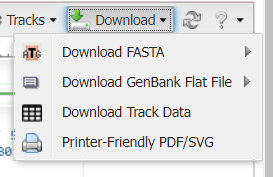


In particular, you may be interested in the options for exporting your current view directly as an image for further editing, choosing the `Printer Friendly` options. 


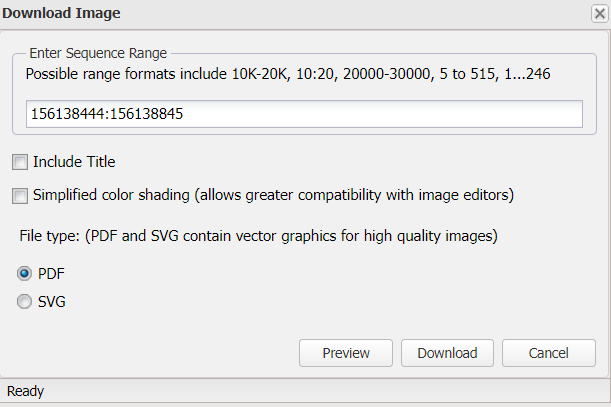


2. **Export an active URL:** 

Using the `Share This Page` option is probably your best bet for a truly reproducible output, as it generates a URL that will allow you to open this exact Genome Data Viewer view, with tracks and interactivity intact. 

Simply go to `Share This Page` and generate a URL for the current configuration. Try this now and test out your own link! 

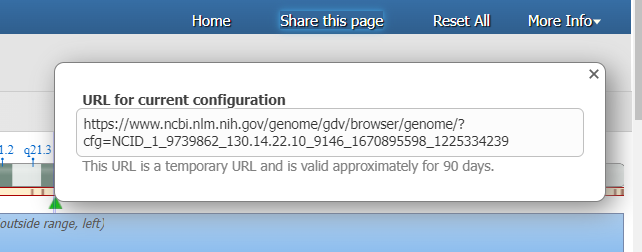

---

## END OF OBJECTIVES! ##

---

## Conclusions <a class="anchor" id="Conclusions"></a>

Summary
--------
MagicBLAST is a powerful next-gen alignment tool that 
* is especially useful for aligning RNA-Seq runs to genomic DNA.
* can access next-gen reads from NCBI's SRA in the cloud
* uses a BLAST database made from the reference to increase the efficiency of the alignemt process
* is splice aware to provide more accurate RNA-seq to genomic alignments.

You used MagicBLAST in bioinformatic workflows that incorporated NCBI Viewers, other NCBI web resources, and local installations of additional standalone tools (NCBI BLAST, NCBI EDirect, and Samtools) to:
 * identify variants in viral next-gen sequence samples
 * annotate genes on an unannotated whale contig using NCBI RefSeq mRNA sequences from a related species
 * look for differences in splicing and expression patterns in disease genotype vs. wild-type cell lines. 
 
The Genome Data Viewer (GDV) is a powerful web-based visualization tool that 
* Facilitates the exploration of NCBI-annotated genomes
* Allows upload of custom user-generated tracks
* Has dynamically-adjusting views for different zoom levels and types of data. 
* Is integrated with the ecosystem of NCBI data, allowing for easy access to additional information 
* Increases reproducbility via export of images and re-usable links. 
In this workshop, you used GDV to
* Upload a custom remote track 
* Locate regions of potential differential expression 
* Add Gene and Variation tracks to relate our data to publicly available dataset. 

Relevant YouTube Playlist: 
----------------------------------
https://www.youtube.com/playlist?list=PL7dF9e2qSW0aPYiX5UMmYAwKhsBzEHa7H


About the Workshop Tools: 
-----------------------------------

**MagicBLAST**  Publication https://ncbi.github.io/magicblast/     GitHub https://ncbi.github.io/magicblast/  Download https://ftp.ncbi.nlm.nih.gov/blast/executables/magicblast/LATEST/
            
**NCBI BLAST**  Documentation https://www.ncbi.nlm.nih.gov/books/NBK279690/     Download https://ftp.ncbi.nlm.nih.gov/blast/executables/blast+/LATEST/
            
**Jupyter**     Documentation https://docs.jupyter.org/en/latest/

**EDirect**     Documentation https://www.ncbi.nlm.nih.gov/books/NBK179288/

**Samtools**    Documentation http://www.htslib.org/

**SRA**         Documentation https://www.ncbi.nlm.nih.gov/sra/docs/

**Genome Data Viewer** Home Page: https://www.ncbi.nlm.nih.gov/genome/gdv/      Documentation and Help: https://www.ncbi.nlm.nih.gov/genome/gdv/browser/help/

Keeping up to date
------------------ 

NCBI Insights https://ncbiinsights.ncbi.nlm.nih.gov/

Follow us on Social  Twitter @ncbi, LinkedIn https://www.linkedin.com/company/ncbinlm/

Questions?
-----------
NCBI Helpdesk https://support.nlm.nih.gov/support/create-case/